## < CSCN8010-24s-Sec1 >
### Foundations of Machine Learning

## Project

<h3> Professor: Urvi Palvankar<br><br>

Group 10 
Members: AeKyung Yang (8978373), Salma Milla Gallegos (8826790)<br><br>

In [1]:
# Common
import os 
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from IPython.display import clear_output as cls

# Data 
from tqdm import tqdm
import tensorflow.data as tfd

# Data Visualization
import matplotlib.pyplot as plt

# Model Building
from tensorflow.keras import layers
from tensorflow.keras import callbacks
from tensorflow.keras import optimizers
from tensorflow.keras import metrics
from tensorflow.keras.optimizers.schedules import ExponentialDecay

# Model visualization
from tensorflow.keras.utils import plot_model

# Extra
from typing import List, Tuple, Union

## Hyperparameters and constants

In [2]:
# Image and Mask Dimensions
IMAGE_HEIGHT = 160
IMAGE_WIDTH = 160
N_IMAGE_CHANNELS = 3
N_MASK_CHANNELS = 1

# Image and Mask Size
IMAGE_SIZE = (IMAGE_WIDTH, IMAGE_HEIGHT, N_IMAGE_CHANNELS)
MASK_SIZE = (IMAGE_WIDTH, IMAGE_HEIGHT, N_MASK_CHANNELS)

# Batch Size and Learning Rate
BATCH_SIZE = 32
BASE_LR = 1e-2

# Model Name
MODEL_NAME = 'UNetForestSegmentation'

# Model Training
EPOCHS = 100

# Data Paths
ROOT_IMAGE_DIR = 'Forest_Segmented/images'
ROOT_MASK_DIR = 'Forest_Segmented/masks'
METADATA_CSV_PATH = 'Forest_Segmented/meta_data.csv'

# Model Architecture
FILTERS = 32

In [3]:
# Random Seed
SEED = 42

np.random.seed(SEED)
tf.random.set_seed(SEED)

## Utility Functions

In [4]:
def load_image_and_mask(image_path: str, mask_path: str) -> Tuple[tf.Tensor, tf.Tensor]:
    
    '''
    This function takes the file paths of an image and its corresponding mask as input. It first reads the images, then decodes them into tensors, 
    and resizes them to a standard size. After that, the image and mask tensors are normalized by clipping the pixel values between 0 and 1. 
    Finally, the function converts the image and mask tensors to the float32 data type and returns them as a tuple.
    
    Arguments : 
        image_path : The path to the image to be loaded. 
        mask_path  : The path to the mask to be loaded.
    
    Returns :
        image : This is the loaded and the processed image. 
        mask  : This is the loaded and the processed mask.
    
    '''
    
    # Read the images
    image = tf.io.read_file(filename = image_path)
    mask  = tf.io.read_file(filename = mask_path)
    
    # Decode the images
    image = tf.image.decode_jpeg(contents = image, channels = N_IMAGE_CHANNELS)
    mask  = tf.image.decode_jpeg(contents = mask,  channels = N_MASK_CHANNELS)
    
    # Convert the image to a Tensor
    image = tf.image.convert_image_dtype(image = image, dtype = tf.float32)
    mask  = tf.image.convert_image_dtype(image = mask, dtype = tf.float32)
    
    # Resize the image to the desired dimensions
    image = tf.image.resize(images = image, size = (IMAGE_WIDTH, IMAGE_HEIGHT))
    mask  = tf.image.resize(images = mask, size = (IMAGE_WIDTH, IMAGE_HEIGHT))
    
    # Normalize the image
    image = tf.clip_by_value(image, clip_value_min = 0.0, clip_value_max = 1.0)
    mask  = tf.clip_by_value(mask, clip_value_min = 0.0, clip_value_max = 1.0)
    
    # Final conversion
    image = tf.cast(image, dtype = tf.float32)
    mask  = tf.cast(mask,  dtype = tf.float32)
    
    return image, mask

In [5]:
# Load CSV File
metadata = pd.read_csv(METADATA_CSV_PATH)

# Quick look
metadata.head()

,image,mask
0,10452_sat_08.jpg,10452_mask_08.jpg
1,10452_sat_18.jpg,10452_mask_18.jpg
2,111335_sat_00.jpg,111335_mask_00.jpg
3,111335_sat_01.jpg,111335_mask_01.jpg
4,111335_sat_02.jpg,111335_mask_02.jpg


In [6]:
# Define indices
start_index = 0
end_index = 1500

# Slice metadata to get the first 2000 entries
metadata_subset = metadata.iloc[start_index:end_index].copy()

# Add root path to image file names and ensure forward slashes
metadata_subset['image'] = [os.path.normpath(os.path.join(ROOT_IMAGE_DIR, filename)).replace('\\', '/') for filename in metadata_subset['image']]

# Add root path to mask file names and ensure forward slashes
metadata_subset['mask'] = [os.path.normpath(os.path.join(ROOT_MASK_DIR, filename)).replace('\\', '/') for filename in metadata_subset['mask']]

In [7]:
# Quick Check
metadata_subset.head()

,image,mask
0,Forest_Segmented/images/10452_sat_08.jpg,Forest_Segmented/masks/10452_mask_08.jpg
1,Forest_Segmented/images/10452_sat_18.jpg,Forest_Segmented/masks/10452_mask_18.jpg
2,Forest_Segmented/images/111335_sat_00.jpg,Forest_Segmented/masks/111335_mask_00.jpg
3,Forest_Segmented/images/111335_sat_01.jpg,Forest_Segmented/masks/111335_mask_01.jpg
4,Forest_Segmented/images/111335_sat_02.jpg,Forest_Segmented/masks/111335_mask_02.jpg


In [8]:
def load_dataset(
    image_paths: list, mask_paths: list, split_ratio: float=0.7, 
    batch_size: int=BATCH_SIZE, shuffle: bool=True, 
    buffer_size: int=1000, n_repeat: int=1
) -> Union[Tuple[tfd.Dataset, tfd.Dataset], tfd.Dataset]:
    '''
    This function loads the image and mask data from the provided file paths and creates a TensorFlow dataset. The function
    first creates space to store the image and mask data in numpy arrays. It then iterates over each image and mask pair, 
    loading them using the load_image_and_mask function and storing them in the numpy arrays.
    
    The function then creates a TensorFlow dataset using the numpy arrays. If shuffle is True, it shuffles the dataset
    with a buffer size of buffer_size. If split_ratio is not None, it splits the dataset into two parts with sizes determined
    by the split_ratio, and converts them into batches of size batch_size with drop_remainder=True. The two resulting datasets
    are returned as a tuple.

    If split_ratio is None, the entire dataset is converted into batches of size batch_size with drop_remainder=True, 
    and the resulting dataset is returned.
    
    Args:
        image_paths: A list of strings, containing the file paths of the input images.
        
        mask_paths: A list of strings, containing the file paths of the corresponding mask images.
        
        split_ratio: A float value between 0 and 1, representing the ratio of data to be used for validation. 
                    If split_ratio is set to None, then no data will be split for validation.
                    
        batch_size: An integer, representing the batch size for the input data.
        
        shuffle: A boolean value indicating whether the data should be shuffled or not.
        
        buffer_size: An integer, representing the buffer size for shuffling the data.
        
        n_repeat: An integer, representing the total number of repetations of the data.
    
    Returns:
        If split_ratio is not None, then the function returns a tuple of two Tensorflow datasets. 
        The first dataset contains the training data and the second dataset contains the validation data.
        
        If split_ratio is None, then the function returns a single Tensorflow dataset containing the 
        input data batched and pre-fetched for training.
    
    '''
    
    # Create space for storing the data.
    images = np.empty(shape=(len(image_paths), *IMAGE_SIZE), dtype=np.float32)
    masks  = np.empty(shape=(len(mask_paths), *MASK_SIZE),  dtype=np.float32)
    
    # Iterate over the data.
    index = 0
    for image_path, mask_path in tqdm(zip(image_paths, mask_paths), desc='Loading'):
        
        # Load the image and the mask.
        image, mask = load_image_and_mask(image_path = image_path, mask_path = mask_path)
        
        # Store the image and the mask.
        images[index] = image
        masks[index]  = mask
        
        # Increment the index.
        index += 1
    
    # Create a Tensorflow data.
    data_set = tfd.Dataset.from_tensor_slices((images, masks)).repeat(n_repeat)
    
    # Shuffle the data set.
    if shuffle:
        data_set = data_set.shuffle(buffer_size)
    
    # Split the data 
    if split_ratio is not None:
        
        split_ratio_val_test = (1 - split_ratio)/2

        # Calculate new data sizes after splitting.
        data_1_len = int(split_ratio * len(images))
        print(data_1_len)
        data_2_len = int(split_ratio_val_test * len(images))
        print(data_2_len)
        
        # Divide the data into 2 parts.
        data_1 = data_set.take(data_1_len)
        data_2 = data_set.skip(data_1_len).take(data_2_len)
        data_3 = data_set.skip(data_1_len + data_2_len).take(data_2_len)
        
        # Convert data into batches.
        data_1 = data_1.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        data_2 = data_2.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        data_3 = data_3.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        
        # Return the data 
        return data_1, data_2, data_3
    
    else:
        
        # Convert data into batches
        data_set = data_set.batch(batch_size, drop_remainder=True).prefetch(tfd.AUTOTUNE)
        
        # Return the data
        return data_set

In [9]:
# Training and Testing Data
train_ds, test_ds, valid_ds = load_dataset(
    image_paths = metadata_subset['image'],
    mask_paths = metadata_subset['mask'],
    split_ratio = 0.7,
    shuffle = True,
    n_repeat=3,
)

Loading: 1500it [00:03, 498.11it/s]


1050
225


In [10]:
print("*"*100)
print(f"{' '*30}Training Data Size : {train_ds.cardinality().numpy() * BATCH_SIZE}")
print(f"{' '*30}Testing Data Size  : {test_ds.cardinality().numpy() * BATCH_SIZE}")
print(f"{' '*30}Validation Data Size  : {valid_ds.cardinality().numpy() * BATCH_SIZE}")
print("*"*100)

****************************************************************************************************
                              Training Data Size : 1024
                              Testing Data Size  : 224
                              Validation Data Size  : 224
****************************************************************************************************


In [12]:
train_ds.cardinality().numpy(),valid_ds.cardinality().numpy(),test_ds.cardinality().numpy()

(32, 7, 7)

## Data Visualization

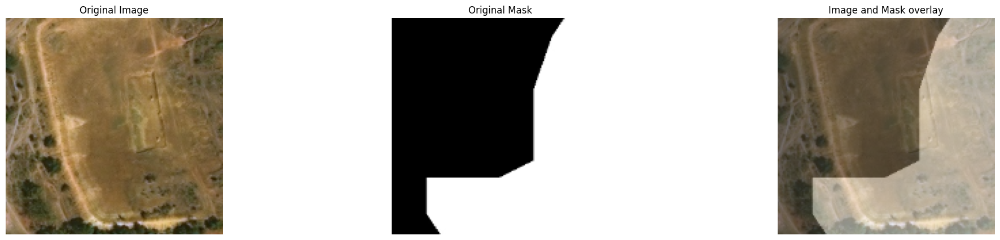

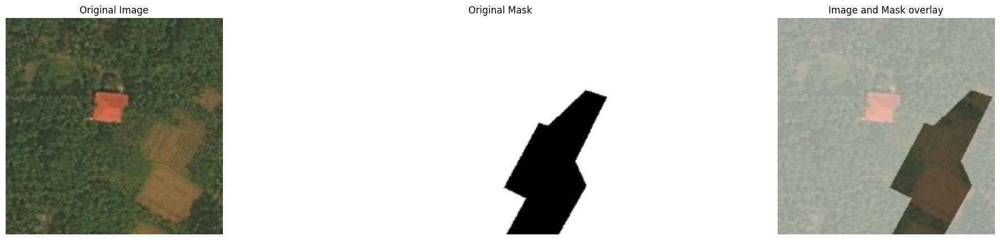

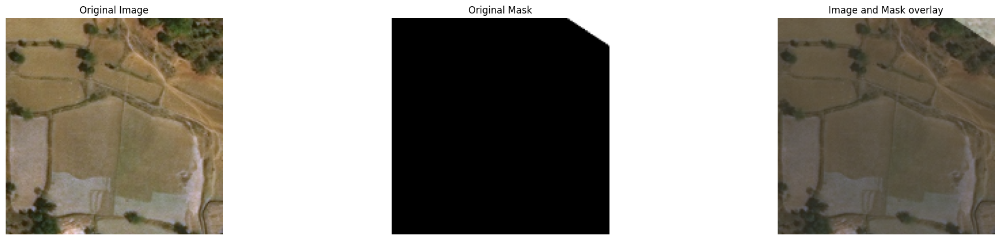

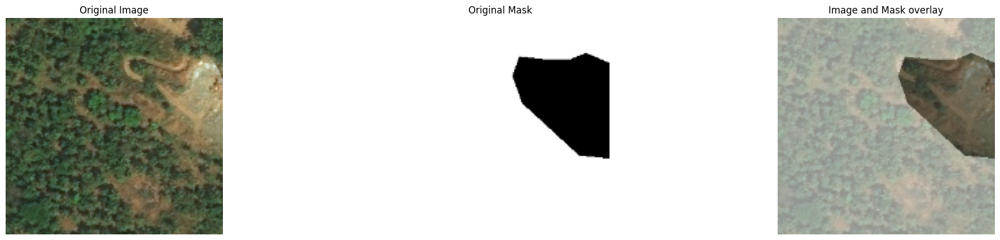

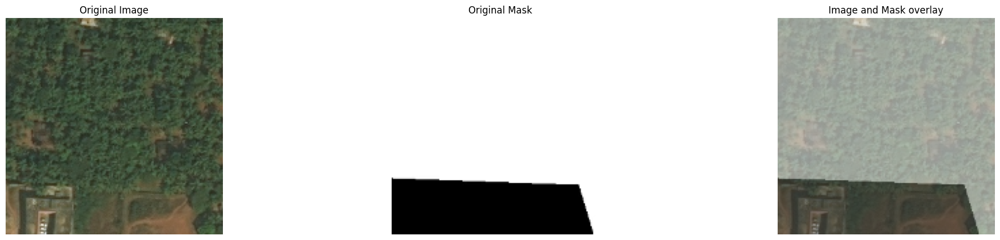

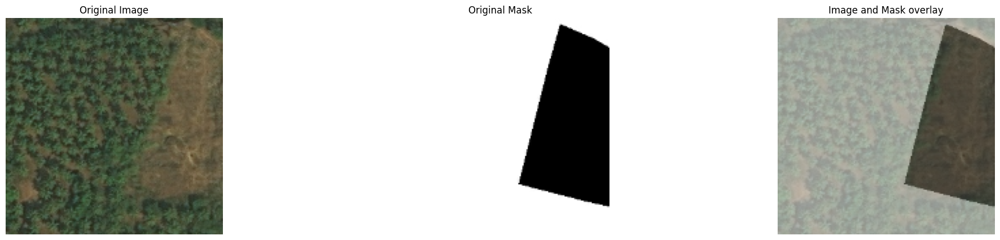

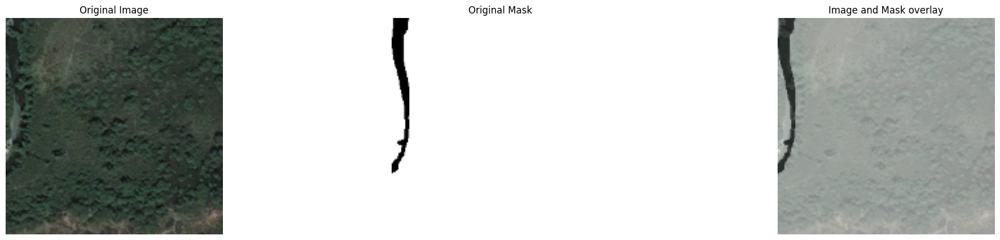

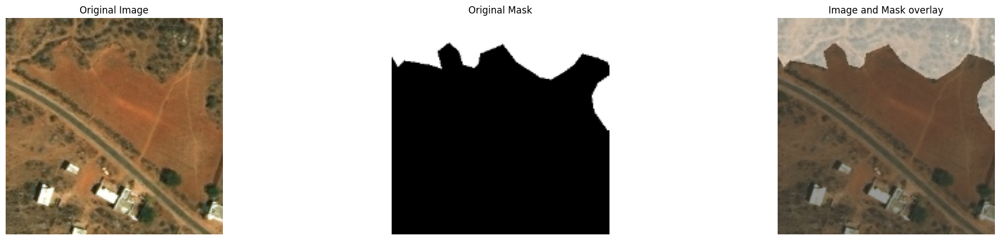

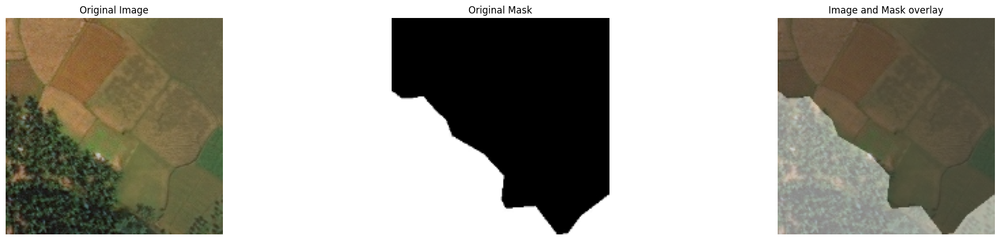

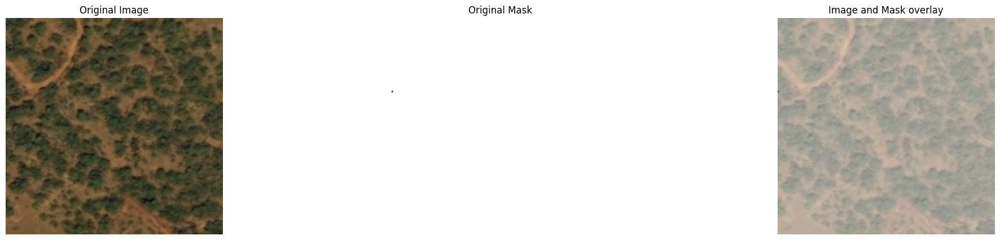

In [14]:
def show_images_and_masks(data : tfd.Dataset, n_images: int=10, FIGSIZE: tuple=(25, 5), model: tf.keras.Model=None):
    # Configuration
    if model is None:
        n_cols = 3
    else:
        n_cols = 5
    
    # Collect the data
    images, masks = next(iter(data))
    
    # Iterate over the data
    for n in range(n_images):
        
        # Plotting configuration
        plt.figure(figsize=FIGSIZE)
        
        # Plot the image
        plt.subplot(1, n_cols, 1)
        plt.title("Original Image")
        plt.imshow(images[n])
        plt.axis('off')
        
        # Plot the Mask
        plt.subplot(1, n_cols, 2)
        plt.title("Original Mask")
        plt.imshow(masks[n], cmap='gray')
        plt.axis('off')
        
        # Plot image and mask overlay
        plt.subplot(1, n_cols, 3)
        plt.title('Image and Mask overlay')
        plt.imshow(masks[n], alpha=0.8, cmap='binary_r')
        plt.imshow(images[n], alpha=0.5)
        plt.axis('off')
        
        # Model predictions
        if model is not None:
            pred_mask = model.predict(tf.expand_dims(images[n], axis=0))[0]
            pred_mask = pred_mask>=0.5 # threshold = 0.5
            plt.subplot(1, n_cols, 4)
            plt.title('Predicted Mask')
            plt.imshow(pred_mask, cmap='gray')
            plt.axis('off')
            
            plt.subplot(1, n_cols, 5)
            plt.title('Predicted Mask Overlay')
            plt.imshow(pred_mask, alpha=0.8, cmap='binary_r')
            plt.imshow(images[n], alpha=0.5)
            plt.axis('off')
    
        # Show final plot
        plt.show()

show_images_and_masks(data=train_ds)

## U-Net
* Image segmentation model 
* Encoder and Decoder with skip connection
* Total: Encoder -16 layers, Decoder - 16 layers
* Parametes: 
<img src='unet.png'>

## Unet - Encoder Block

In [15]:
class EncoderBlock(layers.Layer):
    
    def __init__(self, filters: int, max_pool: bool=True, rate=0.2, **kwargs) -> None:
        super().__init__(**kwargs)
        
        # Params
        self.rate = rate
        self.filters = filters
        self.max_pool = max_pool
        
        # Layers : Initialize the model layers that will be later called
        self.max_pooling = layers.MaxPool2D(pool_size=(2,2), strides=(2,2))
        self.conv1 = layers.Conv2D(
            filters=filters,
            kernel_size=3,
            strides=1,
            padding='same',
            activation='relu',
            kernel_initializer='he_normal'
        )
        self.conv2 = layers.Conv2D(
            filters=filters,
            kernel_size=3,
            strides=1,
            padding='same',
            activation='relu',
            kernel_initializer='he_normal'
        )
        self.drop = layers.Dropout(rate)
        self.bn = layers.BatchNormalization()
        
    def call(self, X, **kwargs):
        
        X = self.bn(X) # BatchNomlarization
        X = self.conv1(X)
        X = self.drop(X)
        X = self.conv2(X)
        
        # Apply Max Pooling if required
        if self.max_pool:
            y = self.max_pooling(X)
            return y, X
        else:
            return X
    
    def get_config(self):
        config = super().get_config()
        config.update({
            'filters': self.filters,
            'max_pool': self.max_pool,
            'rate': self.rate
        })

    def __repr__(self):
        return f"{self.__class__.name}(F={self.filters}, Pooling={self.max_pool})"

## UNet - Decoder Block

In [16]:
class DecoderBlock(layers.Layer):
    
    def __init__(self, filters: int, rate: float = 0.2, **kwargs):
        super().__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        
        # Initialize the model layers
        self.convT = layers.Conv2DTranspose(
            filters = filters,
            kernel_size = 3,
            strides = 2,
            padding = 'same',
            activation = 'relu',
            kernel_initializer = 'he_normal'
        )
        self.bn = layers.BatchNormalization()
        self.net = EncoderBlock(filters = filters, rate = rate, max_pool = False)
        
    def call(self, inputs, **kwargs):
        
        # Get both the inputs
        X, skip_X = inputs
        
        # Up-sample the skip connection
        X = self.bn(X)
        X = self.convT(X)
        
        # Concatenate both inputs
        X = layers.Concatenate(axis=-1)([X, skip_X])
        X = self.net(X)
        
        return X

    def get_config(self):
        config = super().get_config()
        config.update({
            'filters': self.filters,
            'rate': self.rate,
        })
        return config

    def __repr__(self):
        return f"{self.__class__.__name__}(F={self.filters}, rate={self.rate})"

## UNet - Encoder Decoder Net

In [17]:
# Input Layer
input_layer = layers.Input(shape=(IMAGE_SIZE), name="InputLayer")

# The encoder network
pool1, encoder1 = EncoderBlock(FILTERS,   max_pool=True, rate=0.1, name="EncoderLayer1")(input_layer)
pool2, encoder2 = EncoderBlock(FILTERS*2, max_pool=True, rate=0.1, name="EncoderLayer2")(pool1)
pool3, encoder3 = EncoderBlock(FILTERS*4, max_pool=True, rate=0.2, name="EncoderLayer3")(pool2)
pool4, encoder4 = EncoderBlock(FILTERS*8, max_pool=True, rate=0.2, name="EncoderLayer4")(pool3)

# The encoder encoding
encoding = EncoderBlock(FILTERS*16, max_pool=False, rate=0.3, name="EncodingSpace")(pool4)

# The decoder network
decoder4 = DecoderBlock(FILTERS*8, rate=0.2, name="DecoderLayer1")([encoding, encoder4])
decoder3 = DecoderBlock(FILTERS*4, rate=0.2, name="DecoderLayer2")([decoder4, encoder3])
decoder2 = DecoderBlock(FILTERS*2, rate=0.1, name="DecoderLayer3")([decoder3, encoder2])
decoder1 = DecoderBlock(FILTERS,  rate=0.1, name="DecoderLayer4")([decoder2, encoder1])
        
# Final output layer.
final_conv = layers.Conv2D(
    filters = 1, 
    kernel_size = 1, 
    strides=1, 
    padding='same', 
    activation='sigmoid', 
    name="OutputMap"
)(decoder1)

# Unet Model
unet_model = keras.Model(
    inputs = input_layer,
    outputs = final_conv,
    name = "UNetModel"
)

C:\Users\Salma\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\keras\src\layers\layer.py:372: UserWarning: `build()` was called on layer 'EncodingSpace', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
C:\Users\Salma\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\keras\src\layers\layer.py:372: UserWarning: `build()` was called on layer 'encoder_block', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implemen

In [18]:
# Model Summary
unet_model.summary()

Model: "UNetModel"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ InputLayer          │ (None, 160, 160,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ EncoderLayer1       │ [(None, 80, 80,   │     10,156 │ InputLayer[0][0]  │
│ (EncoderBlock)      │ 32), (None, 160,  │            │                   │
│                     │ 160, 32)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ EncoderLayer2       │ [(None, 40, 40,   │     55,552 │ EncoderLayer1[0]… │
│ (EncoderBlock)      │ 64), (None, 80,   │            │                   │
│                     │ 80, 64)]          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ EncoderLayer3       │ [(None, 20, 20,   │    221,696 │ EncoderLayer2[0]… │
│ (EncoderBlock)      │ 128), (None, 40,  │            │                   │
│                     │ 40, 128)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ EncoderLayer4       │ [(None, 10, 10,   │    885,760 │ EncoderLayer3[0]… │
│ (EncoderBlock)      │ 256), (None, 20,  │            │                   │
│                     │ 20, 256)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ EncodingSpace       │ (None, 10, 10,    │  3,540,992 │ EncoderLayer4[0]… │
│ (EncoderBlock)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ DecoderLayer1       │ (None, 20, 20,    │  2,953,984 │ EncodingSpace[0]… │
│ (DecoderBlock)      │ 256)              │            │ EncoderLayer4[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ DecoderLayer2       │ (None, 40, 40,    │    739,712 │ DecoderLayer1[0]… │
│ (DecoderBlock)      │ 128)              │            │ EncoderLayer3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ DecoderLayer3       │ (None, 80, 80,    │    185,536 │ DecoderLayer2[0]… │
│ (DecoderBlock)      │ 64)               │            │ EncoderLayer2[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ DecoderLayer4       │ (None, 160, 160,  │     46,688 │ DecoderLayer3[0]… │
│ (DecoderBlock)      │ 32)               │            │ EncoderLayer1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ OutputMap (Conv2D)  │ (None, 160, 160,  │         33 │ DecoderLayer4[0]… │
│                     │ 1)                │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 8,640,109 (32.96 MB)

 Trainable params: 8,635,303 (32.94 MB)

 Non-trainable params: 4,806 (18.77 KB)

In [19]:
# Inspect trainable and non-trainable parameters
for layer in unet_model.layers:
    print(f"Layer: {layer.name}")
    print(f"  Trainable: {layer.trainable}")
    print(f"  Non-trainable weights: {len(layer.non_trainable_weights)}")
    print(f"  Trainable weights: {len(layer.trainable_weights)}")

Layer: InputLayer
  Trainable: True
  Non-trainable weights: 0
  Trainable weights: 0
Layer: EncoderLayer1
  Trainable: True
  Non-trainable weights: 2
  Trainable weights: 6
Layer: EncoderLayer2
  Trainable: True
  Non-trainable weights: 2
  Trainable weights: 6
Layer: EncoderLayer3
  Trainable: True
  Non-trainable weights: 2
  Trainable weights: 6
Layer: EncoderLayer4
  Trainable: True
  Non-trainable weights: 2
  Trainable weights: 6
Layer: EncodingSpace
  Trainable: True
  Non-trainable weights: 2
  Trainable weights: 6
Layer: DecoderLayer1
  Trainable: True
  Non-trainable weights: 4
  Trainable weights: 10
Layer: DecoderLayer2
  Trainable: True
  Non-trainable weights: 4
  Trainable weights: 10
Layer: DecoderLayer3
  Trainable: True
  Non-trainable weights: 4
  Trainable weights: 10
Layer: DecoderLayer4
  Trainable: True
  Non-trainable weights: 4
  Trainable weights: 10
Layer: OutputMap
  Trainable: True
  Non-trainable weights: 0
  Trainable weights: 2


## UNet - Model Training

In [20]:
class ShowProgress(callbacks.Callback):
    """A callback that displays the original image, the original mask, 
    the predicted mask, and the Grad-CAM visualization for a sample image 
    after each epoch of training.
    
    Args:
        data (tf.data.Dataset): A dataset of image-mask pairs.
        layer_name (str): The name of the layer to use for Grad-CAM.
        cmap (str, optional): The colormap to use for displaying the masks. 
            Defaults to 'gray'.
        output_dir (str, optional): The directory to save the output images. 
            If None, the images will not be saved. Defaults to None.
        num_images (int, optional): The number of images to display. 
            Defaults to 1.
        file_format (str, optional): The format to save the output images in. 
            Defaults to 'png'.
    """
    def __init__(self, data: tf.data.Dataset, layer_name: str, cmap: str = 'gray', 
                 output_dir: str = None, num_images: int = 1, file_format: str = 'png',
                 **kwargs):
        super().__init__(**kwargs)
        
        # Validate inputs
        if not isinstance(data, tf.data.Dataset):
            raise ValueError('The `data` parameter must be a tf.data.Dataset.')
        if not isinstance(layer_name, str):
            raise ValueError('The `layer_name` parameter must be a string.')
        if not isinstance(num_images, int) or num_images < 1:
            raise ValueError('The `num_images` parameter must be an integer greater than 0.')
        if file_format not in ['png', 'jpg', 'pdf']:
            raise ValueError('The `file_format` parameter must be "png", "jpg", or "pdf".')
        
        self.data = data
        self.layer_name = layer_name
        self.cmap = cmap
        self.output_dir = output_dir
        self.num_images = num_images
        self.file_format = file_format
    
    def on_epoch_end(self, epoch, logs=None):
        """Displays the original image, the original mask, the predicted mask, 
        and the Grad-CAM visualization for a sample image.
        """
        # Plotting configuration
        plt.figure(figsize=(25, 8 * self.num_images))
        
        for i in range(self.num_images):
            # Get Data 
            images, masks = next(iter(self.data))
            images = images.numpy()
            masks = masks.numpy()

            # Select image
            index = np.random.randint(len(images))
            image, mask = images[index], masks[index]

            # Make Prediction
            pred_mask = self.model.predict(np.expand_dims(image, axis=0))[0]

            # Show Image
            plt.subplot(1, 3, 1)
            plt.title("Original Image")
            plt.imshow(image)
            plt.axis('off')

            # Show Mask
            plt.subplot(1, 3, 2)
            plt.title("Original Mask")
            plt.imshow(mask, cmap=self.cmap)
            plt.axis('off')

            # Show Model Pred
            plt.subplot(1, 3, 3)
            plt.title("Predicted Mask")
            plt.imshow(pred_mask, cmap=self.cmap)
            plt.axis('off')

             # Save figure
            if self.output_dir is not None:
                path = os.path.join(os.curdir, self.output_dir)
                plt.savefig(f'Epoch({epoch+1})-Viz.{self.file_format}')

            # Show Final plot
            plt.show()

In [21]:
test_images, test_masks = next(iter(test_ds))

CALLBACKS = [
    callbacks.EarlyStopping(
        patience = 10, 
        restore_best_weights = True),
#     callbacks.ModelCheckpoint(
#         MODEL_NAME + '.h5', 
#         save_best_only = True),
    ShowProgress(
        data = valid_ds,
        layer_name = "DecoderLayer4"
    )
]

In [22]:
def dice_coeff(y_true: tf.Tensor, y_pred: tf.Tensor, smooth: float=1.0) -> tf.Tensor:
    
    """Compute the Dice coefficient between predicted and true masks.

    Args:
        y_true (tf.Tensor): True masks. Shape (batch_size, height, width, num_channels).
        y_pred (tf.Tensor): Predicted masks. Shape (batch_size, height, width, num_channels).
        smooth (float): Smoothing factor to avoid division by zero.

    Returns:
        tf.Tensor: Dice coefficient score.

    """
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1, 2, 3])
    union = tf.reduce_sum(y_true, axis=[1, 2, 3]) + tf.reduce_sum(y_pred, axis=[1, 2, 3])
    dice = tf.reduce_mean((2.0 * intersection + smooth) / (union + smooth), axis=0)

    return tf.cast(dice, tf.float32)

In [23]:
# Pixel Accuracy 
pixel_acc = metrics.Accuracy(name="PixelAccuracy")

# Mean Intersection Over Union
mean_iou = metrics.MeanIoU(num_classes=2, name="MeanIoU")

# Exponential learning rate decay
'''
For example,
At Step 0: Learning Rate = 0.001
At Step 500: Learning Rate = 0.001 * 0.96 = 0.00096
At Step 1000: Learning Rate = 0.00096 * 0.96 = 0.0009216
And so on...
'''
initial_learning_rate = BASE_LR
decay_steps = 500  # learning rate will be updated everey 500 steps,
decay_rate = 0.96  # learning rate = learning rate * decay_reate, so lr will decrease 4% 

lr_schedule = ExponentialDecay(
    initial_learning_rate,
    decay_steps,
    decay_rate,
    staircase=True  # learnning rate will drop like step, if staircase=False, it will drop smoothly.
)

optimizer = optimizers.Adam(learning_rate=lr_schedule)

# Compile Model
unet_model.compile(
    loss = 'binary_crossentropy',
    optimizer = optimizer,
    metrics = [
        pixel_acc,
        mean_iou,
        dice_coeff
    ]
)

Epoch 1/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step- MeanIoU: 0.1953 - PixelAccuracy: 7.7410e-07 - dice_coeff: 0.5757 - loss: 0.73


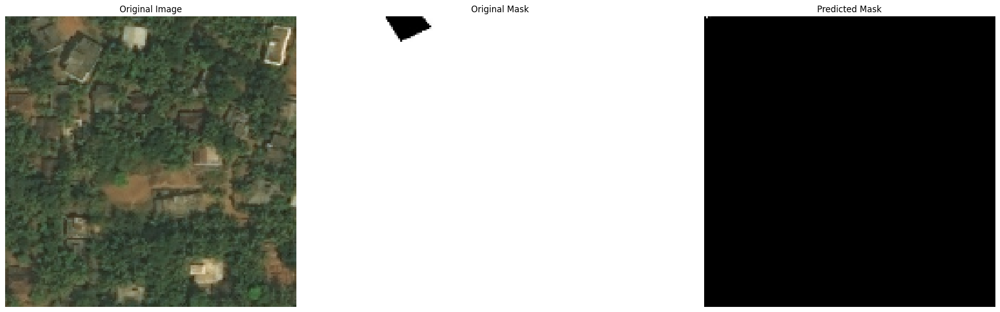

32/32 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - MeanIoU: 0.1955 - PixelAccuracy: 7.5642e-07 - dice_coeff: 0.5764 - loss: 0.7291 - val_MeanIoU: 0.2000 - val_PixelAccuracy: 0.3758 - val_dice_coeff: 0.0024 - val_loss: 2211.1560
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - MeanIoU: 0.2037 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6165 - loss: 0.536


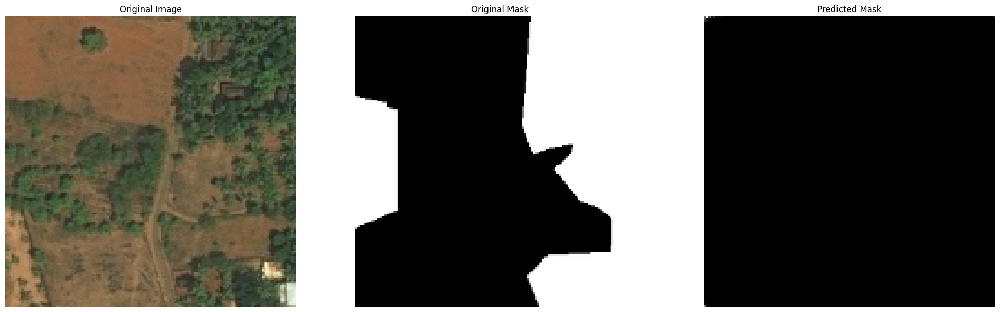

32/32 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - MeanIoU: 0.2038 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6165 - loss: 0.5363 - val_MeanIoU: 0.2040 - val_PixelAccuracy: 0.3475 - val_dice_coeff: 0.0017 - val_loss: 158.6864
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - MeanIoU: 0.2136 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6170 - loss: 0.510


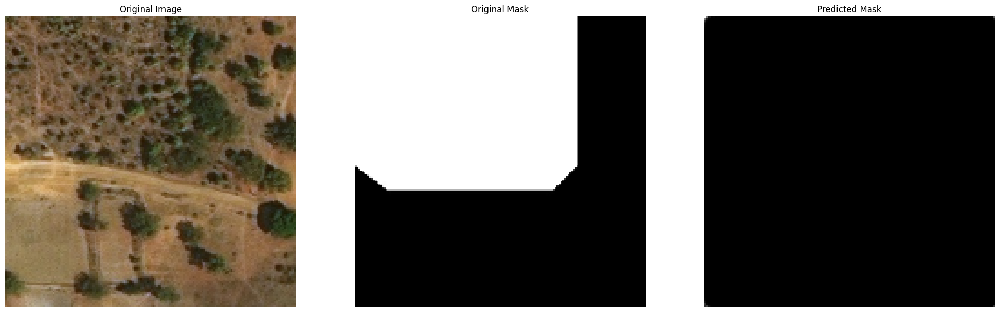

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2134 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6172 - loss: 0.5109 - val_MeanIoU: 0.2069 - val_PixelAccuracy: 0.3203 - val_dice_coeff: 0.0035 - val_loss: 78.7073
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - MeanIoU: 0.1999 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6504 - loss: 0.478


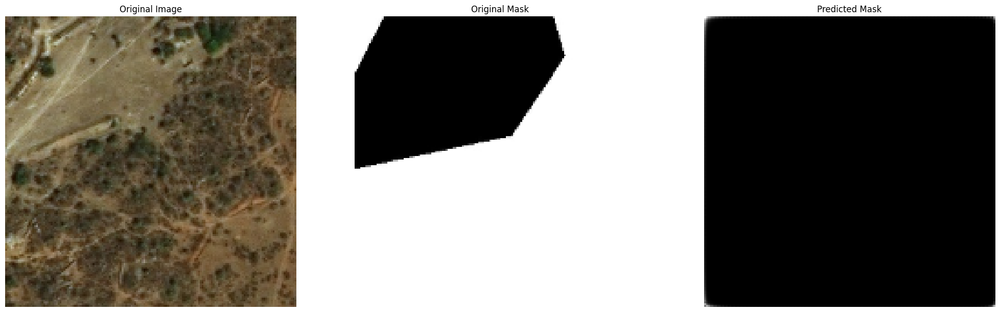

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2000 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6503 - loss: 0.4788 - val_MeanIoU: 0.2123 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.0155 - val_loss: 25.3732
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - MeanIoU: 0.1975 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6645 - loss: 0.465


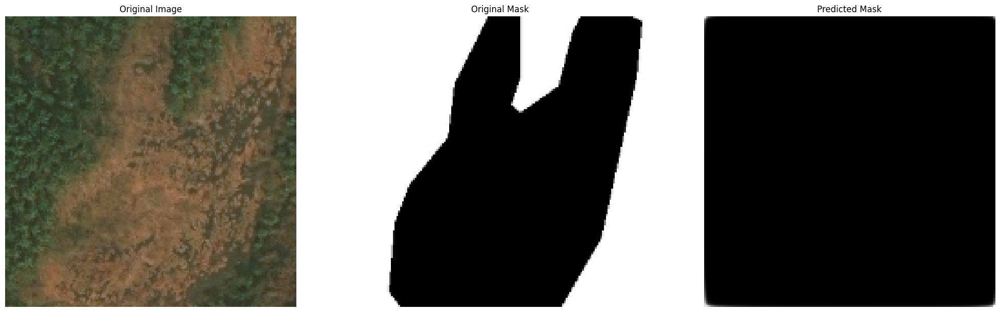

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.1975 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6644 - loss: 0.4655 - val_MeanIoU: 0.2029 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.0423 - val_loss: 19.0655
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - MeanIoU: 0.2029 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6370 - loss: 0.470


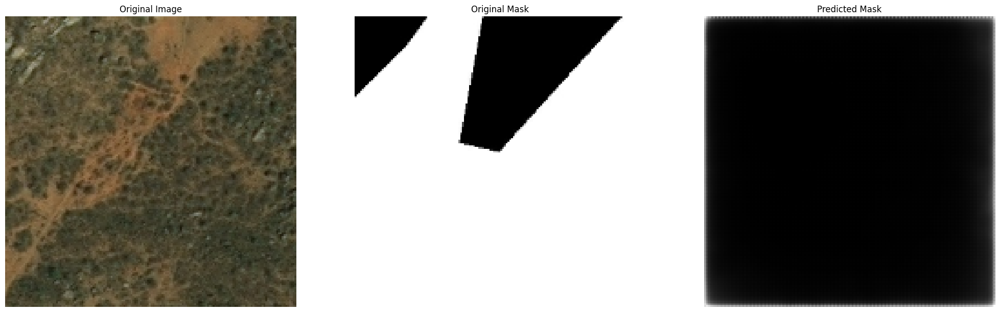

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2029 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6371 - loss: 0.4714 - val_MeanIoU: 0.2169 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.0794 - val_loss: 2.7798
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - MeanIoU: 0.2124 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6254 - loss: 0.474


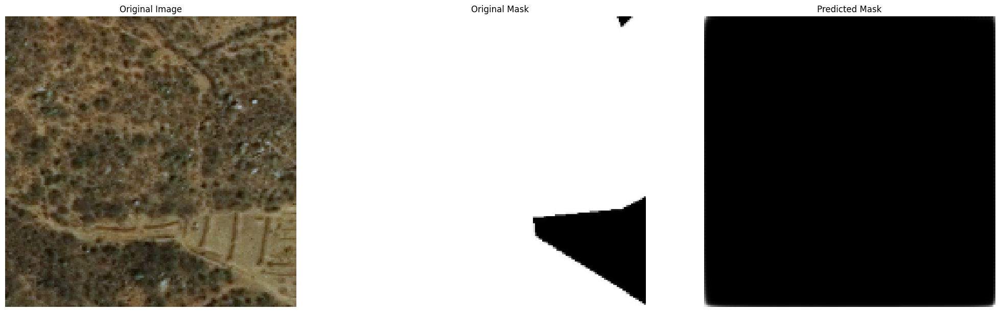

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2122 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6258 - loss: 0.4750 - val_MeanIoU: 0.1785 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.0153 - val_loss: 14.4787
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - MeanIoU: 0.2053 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6446 - loss: 0.458


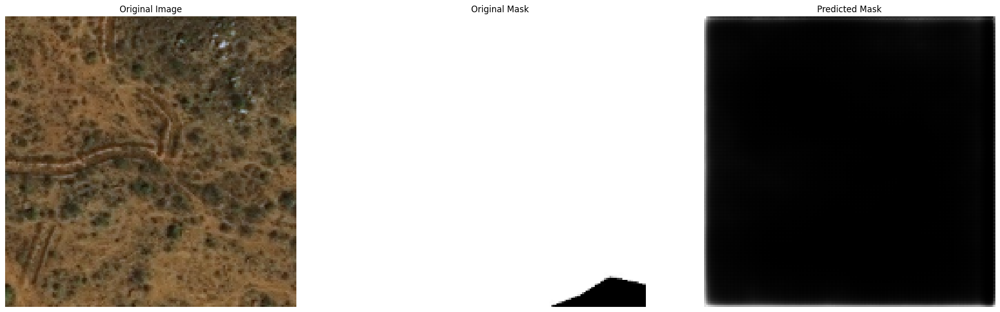

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2052 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6445 - loss: 0.4592 - val_MeanIoU: 0.1998 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.0470 - val_loss: 4.3547
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - MeanIoU: 0.2048 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6372 - loss: 0.466


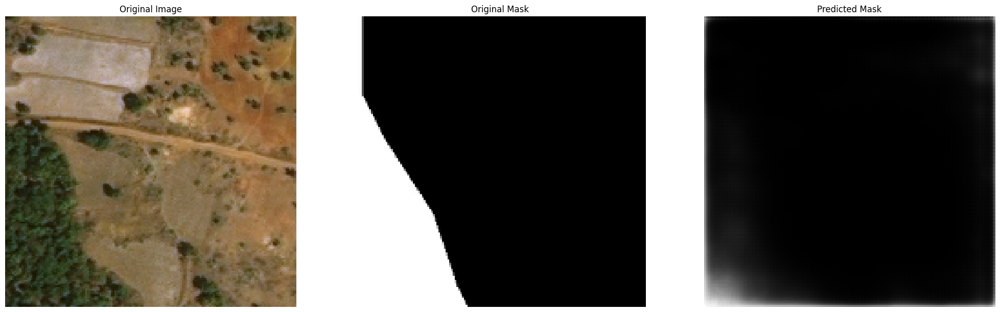

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2050 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6370 - loss: 0.4672 - val_MeanIoU: 0.1840 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.1318 - val_loss: 2.5210
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - MeanIoU: 0.2081 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6429 - loss: 0.448


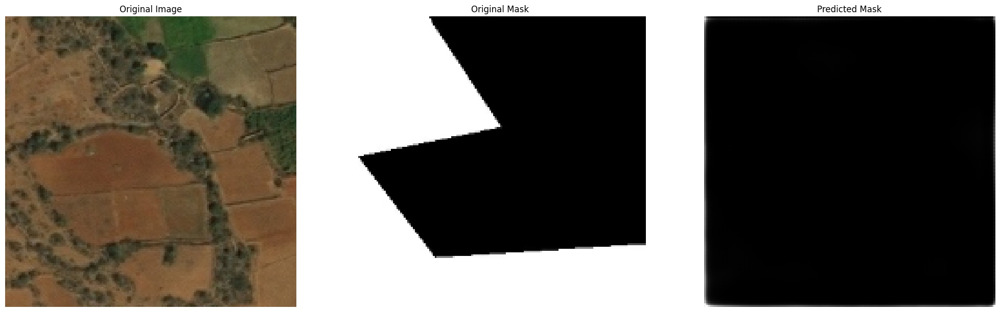

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2080 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6432 - loss: 0.4483 - val_MeanIoU: 0.2063 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.2170 - val_loss: 2.6700
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - MeanIoU: 0.2113 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6418 - loss: 0.465


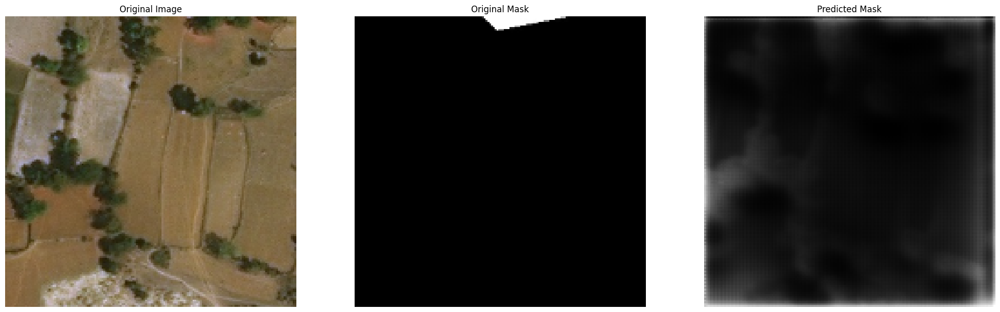

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2112 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6419 - loss: 0.4658 - val_MeanIoU: 0.2040 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.5801 - val_loss: 0.6076
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - MeanIoU: 0.2036 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6475 - loss: 0.450


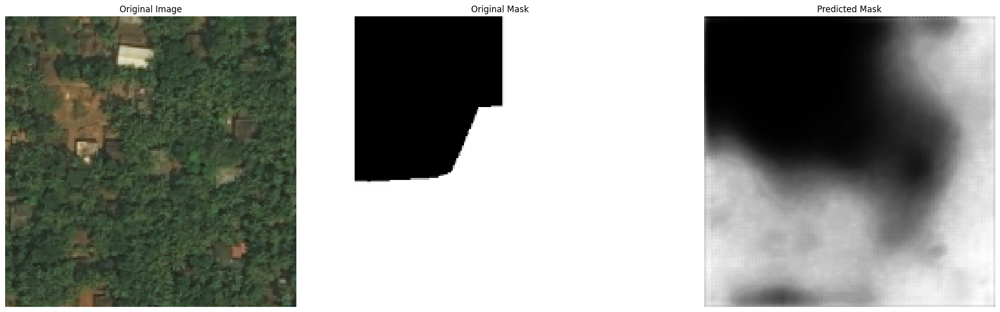

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2035 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6479 - loss: 0.4503 - val_MeanIoU: 0.2094 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.2787 - val_loss: 2.6653
Epoch 13/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - MeanIoU: 0.2068 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6562 - loss: 0.449


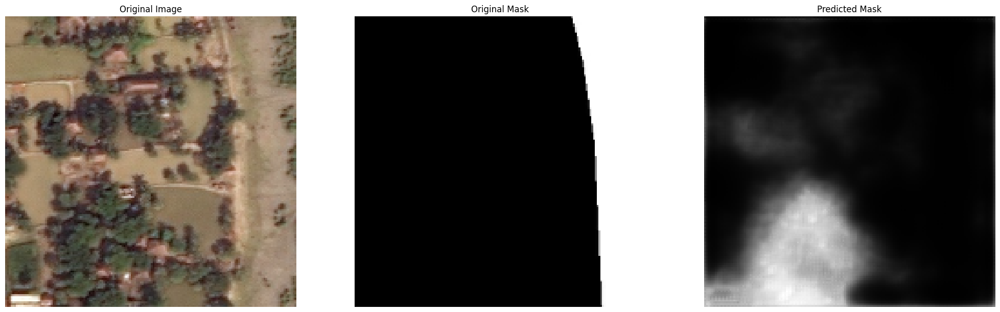

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2068 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6561 - loss: 0.4489 - val_MeanIoU: 0.2000 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.4756 - val_loss: 1.1738
Epoch 14/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - MeanIoU: 0.2105 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6632 - loss: 0.421


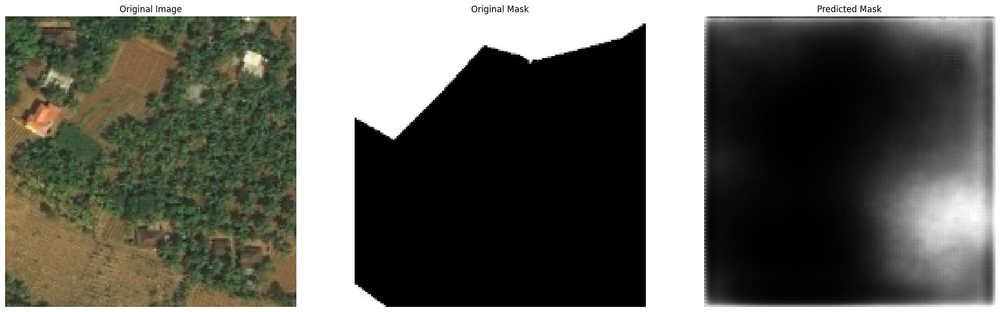

32/32 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - MeanIoU: 0.2105 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6629 - loss: 0.4217 - val_MeanIoU: 0.1981 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.2818 - val_loss: 1.7027
Epoch 15/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - MeanIoU: 0.2014 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6603 - loss: 0.448


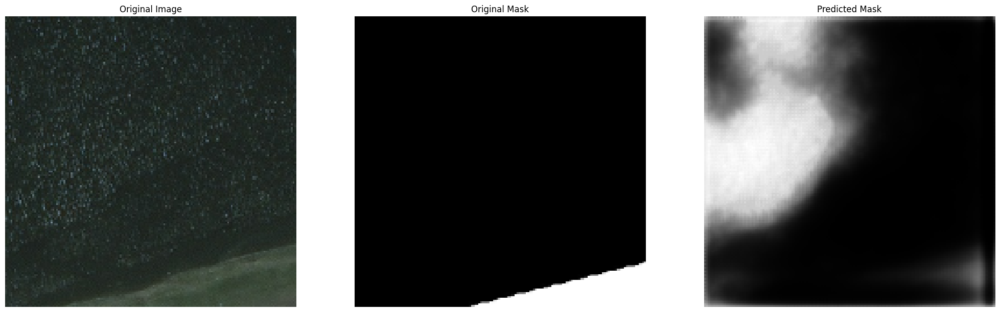

32/32 ━━━━━━━━━━━━━━━━━━━━ 67s 2s/step - MeanIoU: 0.2015 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6602 - loss: 0.4490 - val_MeanIoU: 0.2160 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.4432 - val_loss: 1.3020
Epoch 16/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - MeanIoU: 0.2137 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6348 - loss: 0.457


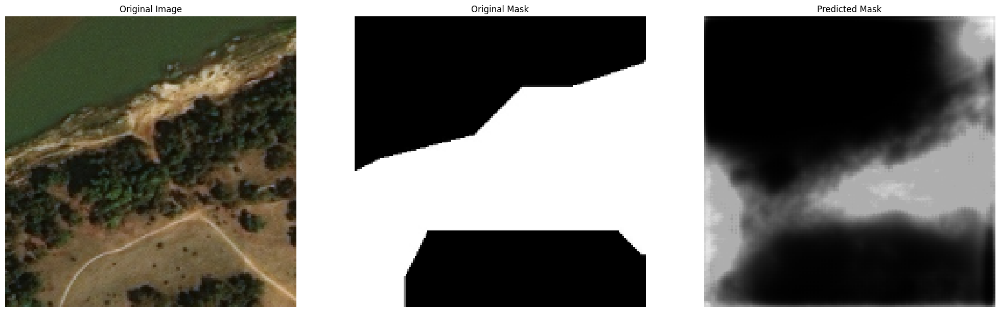

32/32 ━━━━━━━━━━━━━━━━━━━━ 67s 2s/step - MeanIoU: 0.2133 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6357 - loss: 0.4576 - val_MeanIoU: 0.2224 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.5913 - val_loss: 0.7013
Epoch 17/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - MeanIoU: 0.2055 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6704 - loss: 0.423


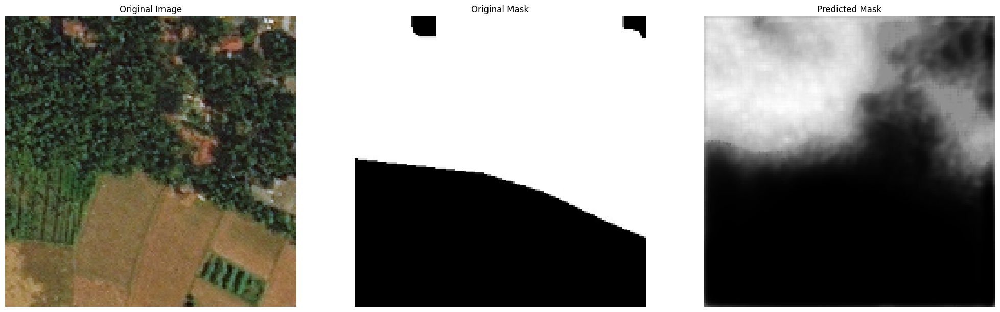

32/32 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - MeanIoU: 0.2057 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6702 - loss: 0.4240 - val_MeanIoU: 0.2235 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.3283 - val_loss: 1.2856
Epoch 18/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - MeanIoU: 0.2026 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6732 - loss: 0.402


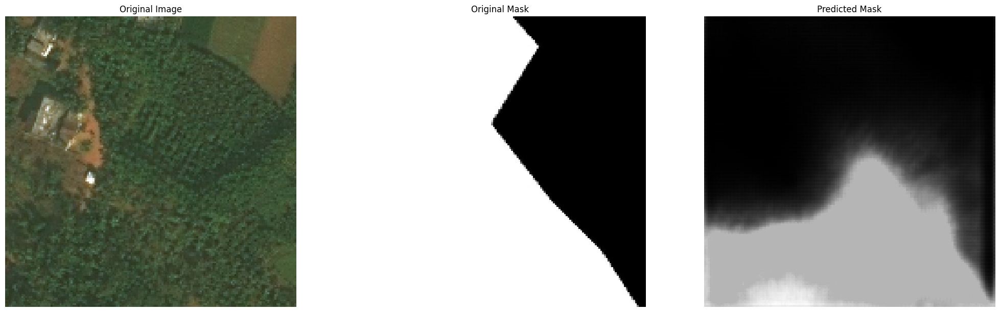

32/32 ━━━━━━━━━━━━━━━━━━━━ 68s 2s/step - MeanIoU: 0.2026 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6733 - loss: 0.4029 - val_MeanIoU: 0.1886 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.4122 - val_loss: 1.3875
Epoch 19/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - MeanIoU: 0.2131 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6556 - loss: 0.426


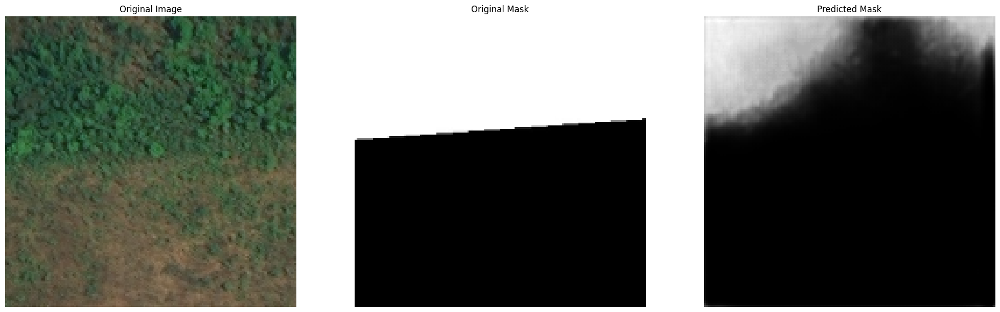

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2129 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6562 - loss: 0.4263 - val_MeanIoU: 0.2155 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.5022 - val_loss: 0.8983
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - MeanIoU: 0.2023 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6678 - loss: 0.416


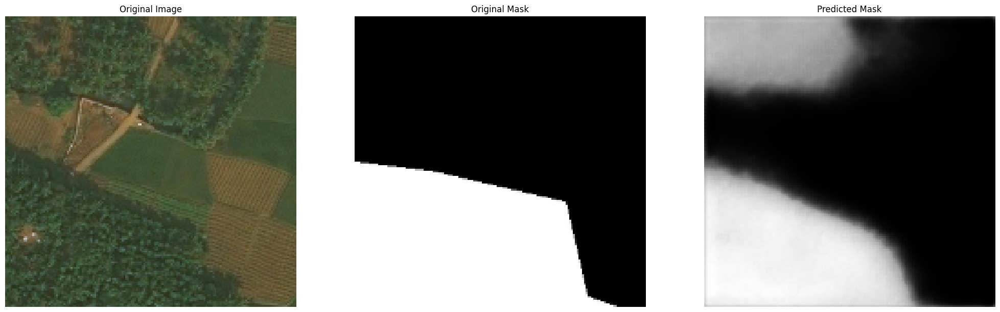

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2025 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6679 - loss: 0.4163 - val_MeanIoU: 0.2131 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6230 - val_loss: 0.5877
Epoch 21/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - MeanIoU: 0.2027 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6764 - loss: 0.405


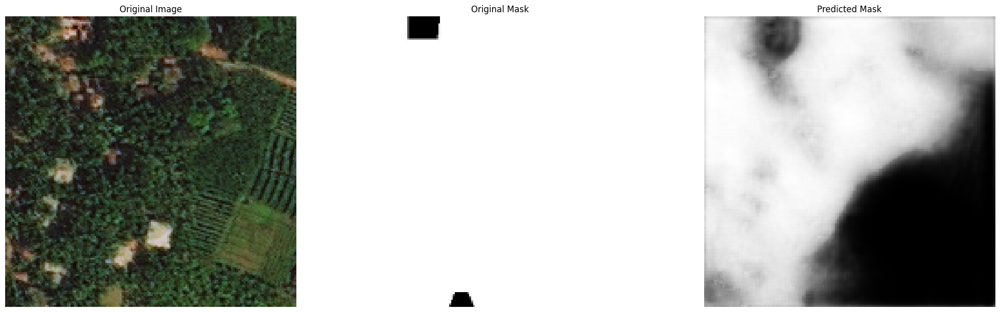

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2028 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6762 - loss: 0.4058 - val_MeanIoU: 0.2200 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.4770 - val_loss: 0.8206
Epoch 22/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - MeanIoU: 0.2135 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6626 - loss: 0.416


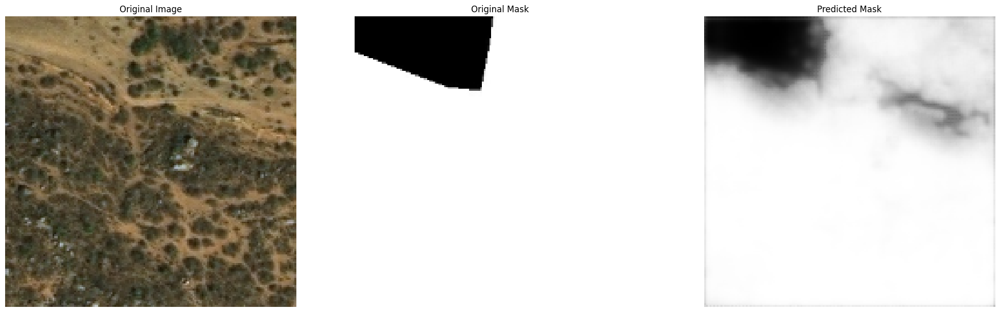

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2131 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6630 - loss: 0.4163 - val_MeanIoU: 0.1916 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7351 - val_loss: 0.5219
Epoch 23/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - MeanIoU: 0.2094 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6714 - loss: 0.411


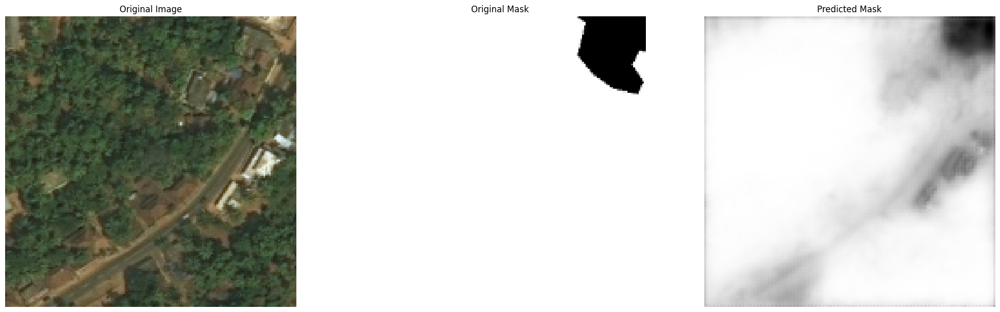

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2093 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6715 - loss: 0.4117 - val_MeanIoU: 0.1996 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7330 - val_loss: 0.6408
Epoch 24/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - MeanIoU: 0.2061 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6814 - loss: 0.399


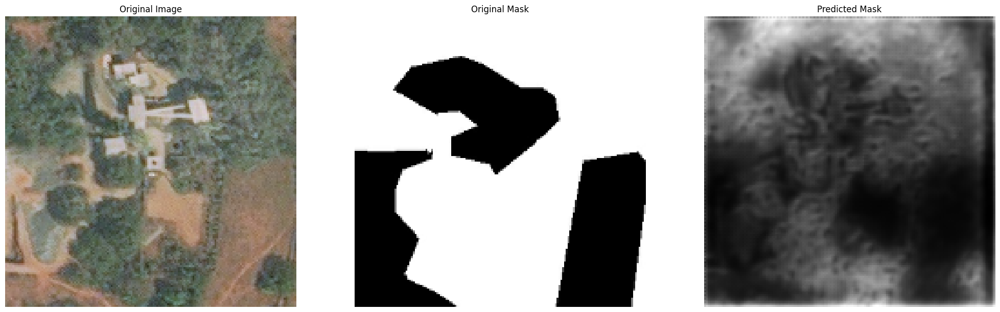

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2062 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6810 - loss: 0.4002 - val_MeanIoU: 0.1916 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6788 - val_loss: 0.4418
Epoch 25/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - MeanIoU: 0.2006 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6744 - loss: 0.417


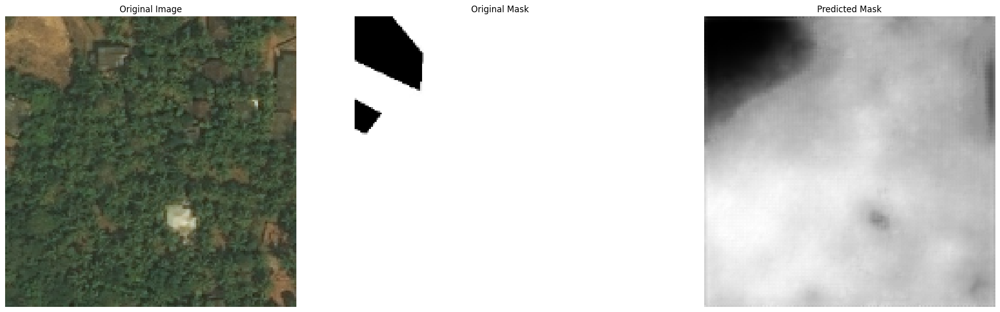

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2008 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6743 - loss: 0.4173 - val_MeanIoU: 0.2134 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.5442 - val_loss: 0.5786
Epoch 26/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - MeanIoU: 0.2001 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6675 - loss: 0.425


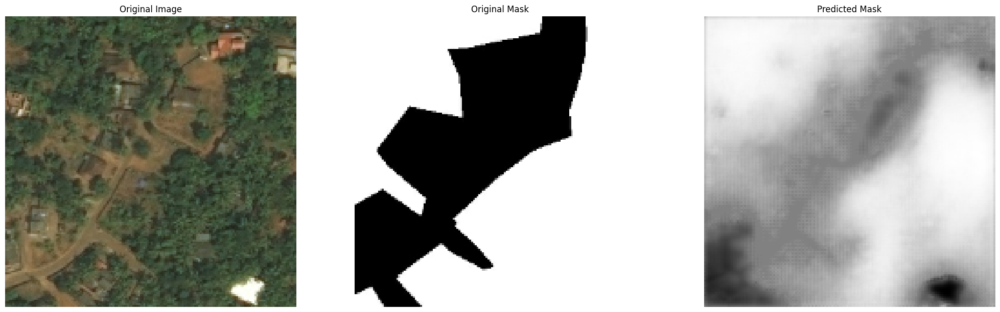

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2001 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6678 - loss: 0.4251 - val_MeanIoU: 0.2055 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6549 - val_loss: 0.4363
Epoch 27/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - MeanIoU: 0.2041 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6863 - loss: 0.386


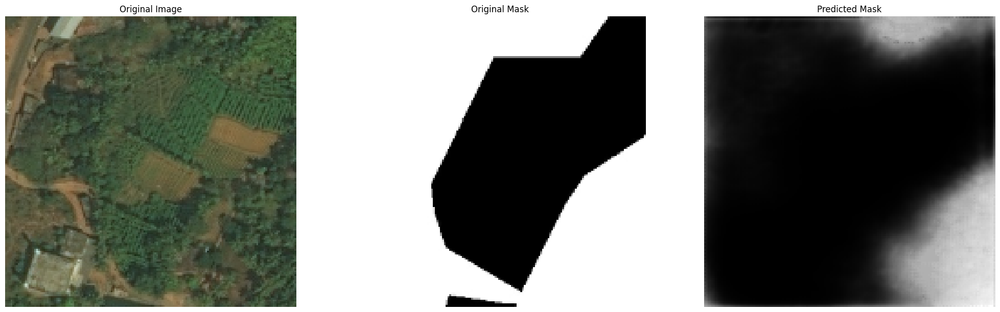

32/32 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - MeanIoU: 0.2041 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6861 - loss: 0.3869 - val_MeanIoU: 0.2087 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.5097 - val_loss: 0.7656
Epoch 28/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - MeanIoU: 0.1990 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6716 - loss: 0.393


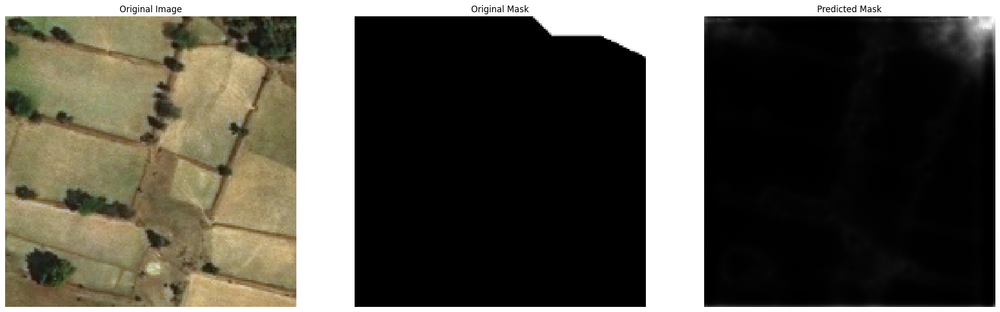

32/32 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - MeanIoU: 0.1991 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6715 - loss: 0.3941 - val_MeanIoU: 0.2002 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6198 - val_loss: 0.4951
Epoch 29/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - MeanIoU: 0.2024 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6895 - loss: 0.379


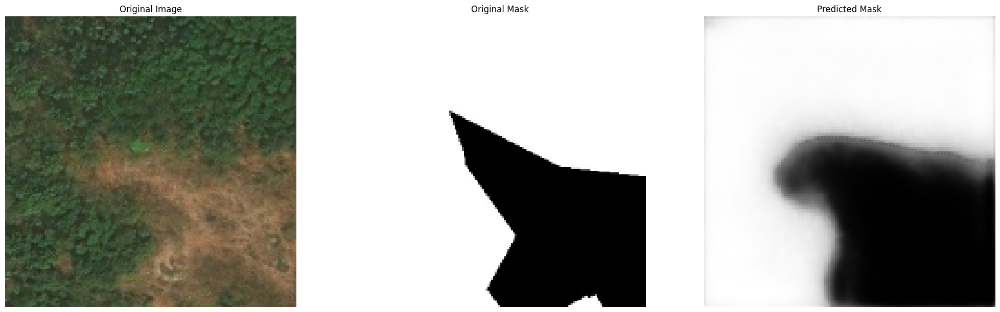

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2024 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6892 - loss: 0.3796 - val_MeanIoU: 0.2229 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6704 - val_loss: 0.4801
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - MeanIoU: 0.2027 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6837 - loss: 0.393


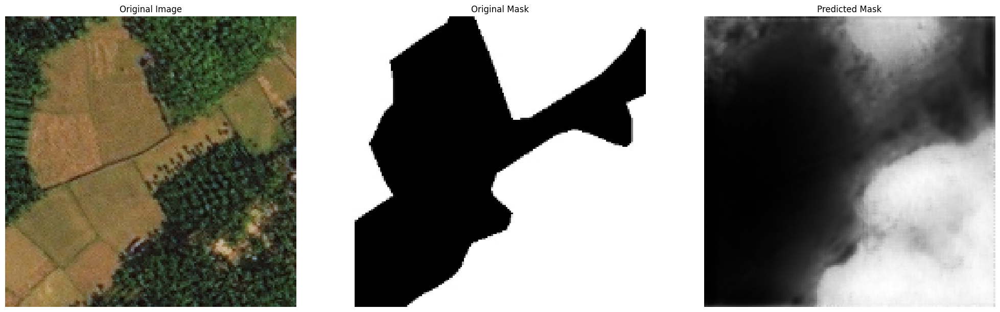

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2027 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6836 - loss: 0.3935 - val_MeanIoU: 0.1855 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6057 - val_loss: 0.5543
Epoch 31/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - MeanIoU: 0.1981 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6964 - loss: 0.386


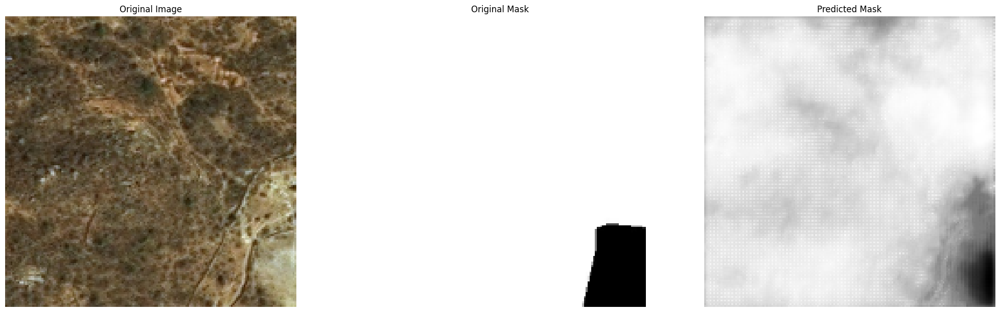

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.1981 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6963 - loss: 0.3861 - val_MeanIoU: 0.1994 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7256 - val_loss: 0.4344
Epoch 32/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - MeanIoU: 0.2029 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6942 - loss: 0.389


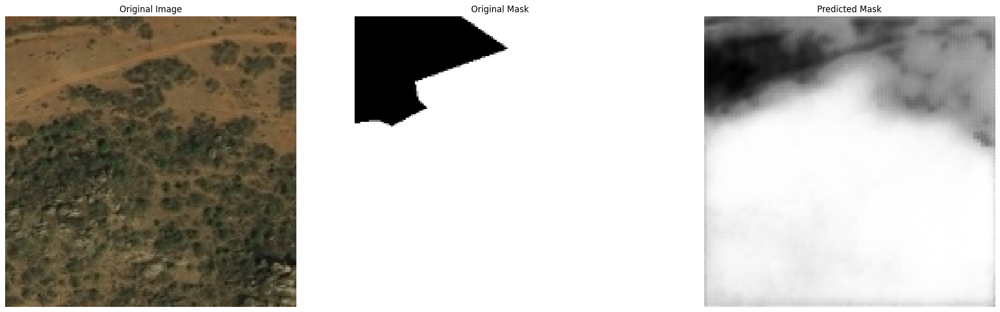

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2028 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6941 - loss: 0.3901 - val_MeanIoU: 0.2168 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6799 - val_loss: 0.4103
Epoch 33/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - MeanIoU: 0.2034 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6679 - loss: 0.399


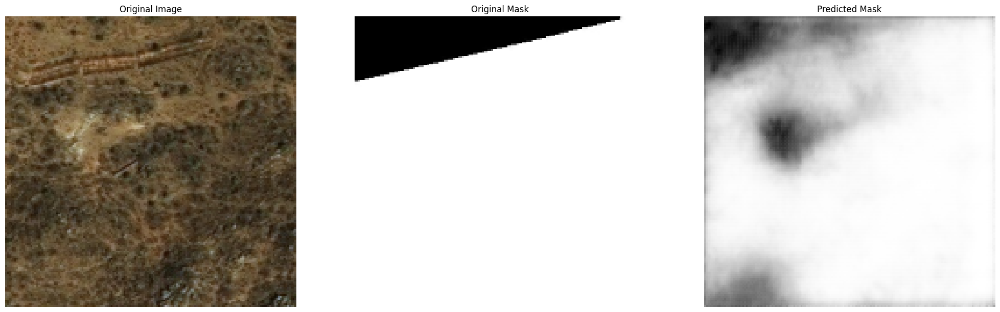

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2035 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6681 - loss: 0.3993 - val_MeanIoU: 0.2016 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7077 - val_loss: 0.4347
Epoch 34/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - MeanIoU: 0.2018 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6803 - loss: 0.400


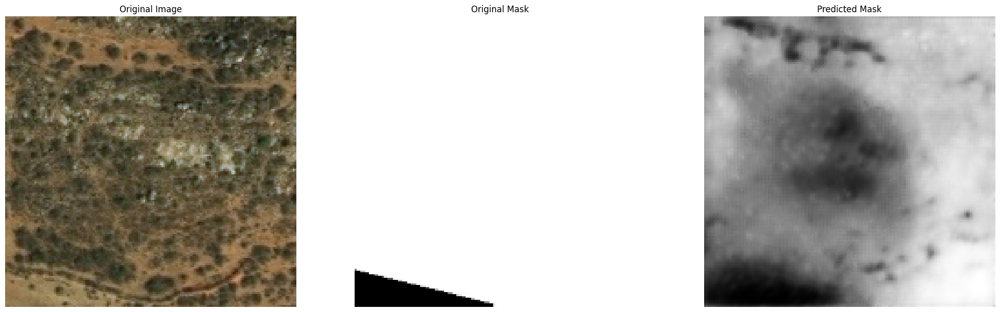

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2018 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6804 - loss: 0.4009 - val_MeanIoU: 0.2158 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6156 - val_loss: 0.4675
Epoch 35/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - MeanIoU: 0.2028 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6906 - loss: 0.373


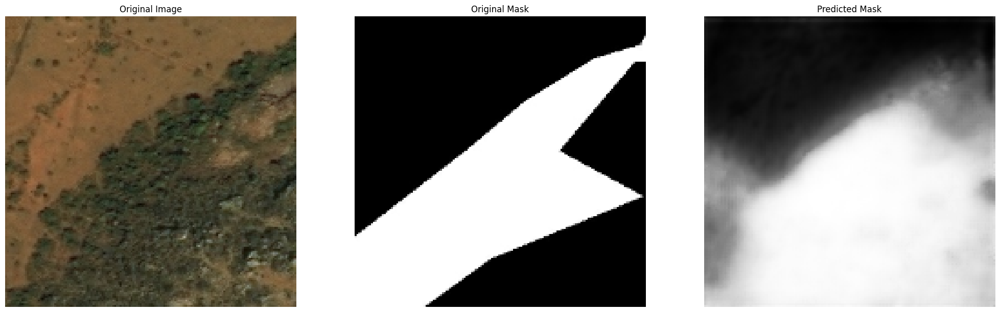

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2030 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6902 - loss: 0.3739 - val_MeanIoU: 0.2052 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7184 - val_loss: 0.3623
Epoch 36/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - MeanIoU: 0.2006 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.7026 - loss: 0.363


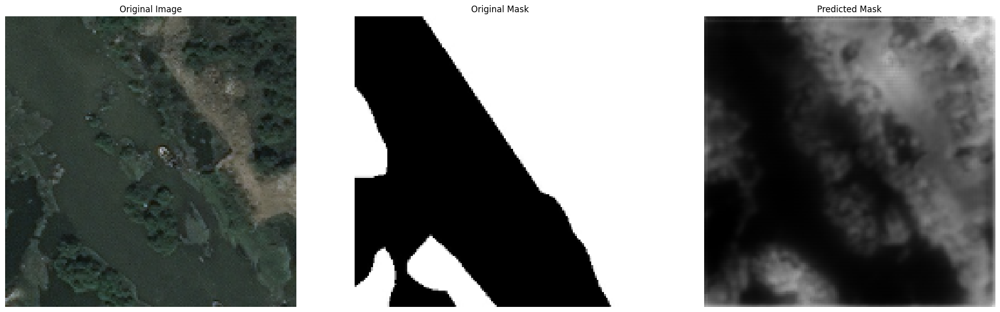

32/32 ━━━━━━━━━━━━━━━━━━━━ 66s 2s/step - MeanIoU: 0.2007 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.7023 - loss: 0.3637 - val_MeanIoU: 0.2227 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6607 - val_loss: 0.3603
Epoch 37/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - MeanIoU: 0.1988 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6915 - loss: 0.381


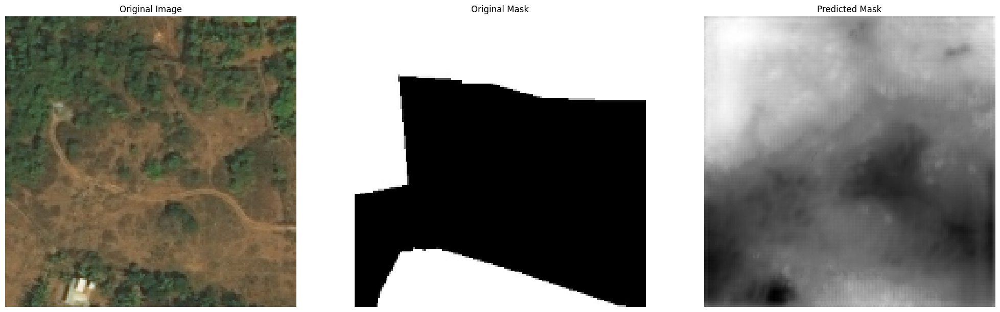

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.1989 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6914 - loss: 0.3816 - val_MeanIoU: 0.2118 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6805 - val_loss: 0.3887
Epoch 38/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - MeanIoU: 0.1990 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.7049 - loss: 0.361


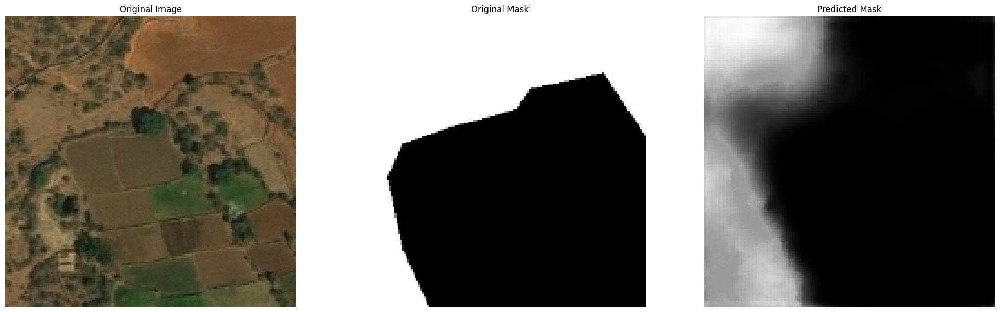

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.1992 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.7044 - loss: 0.3625 - val_MeanIoU: 0.2003 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7084 - val_loss: 0.4957
Epoch 39/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - MeanIoU: 0.2047 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6970 - loss: 0.366


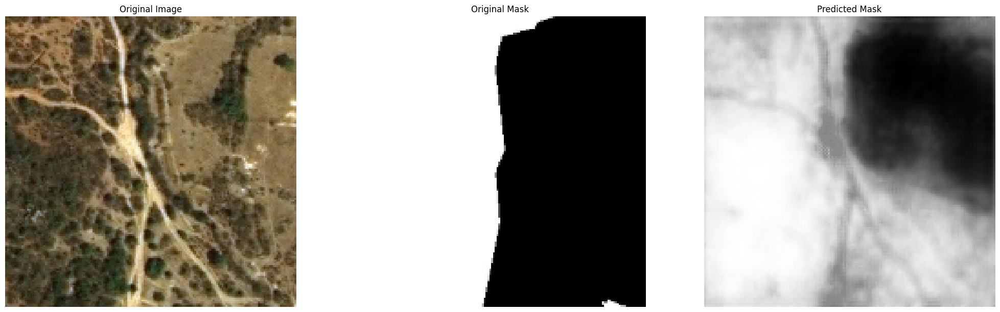

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2047 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6970 - loss: 0.3665 - val_MeanIoU: 0.1988 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6954 - val_loss: 0.3742
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - MeanIoU: 0.2096 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6706 - loss: 0.401


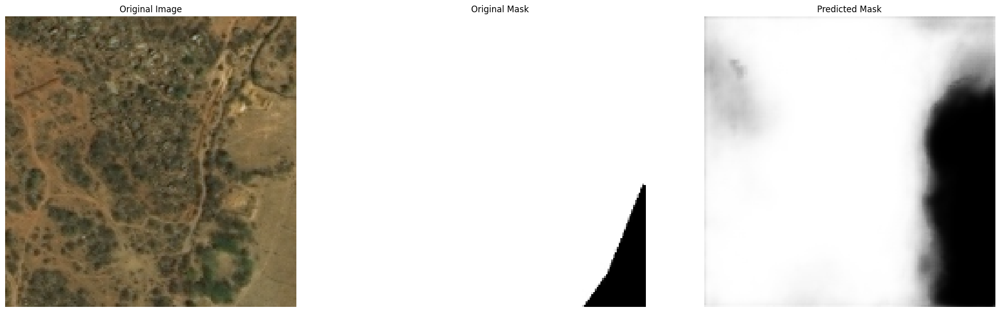

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2094 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6710 - loss: 0.4015 - val_MeanIoU: 0.2065 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7359 - val_loss: 0.5942
Epoch 41/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - MeanIoU: 0.2073 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6944 - loss: 0.357


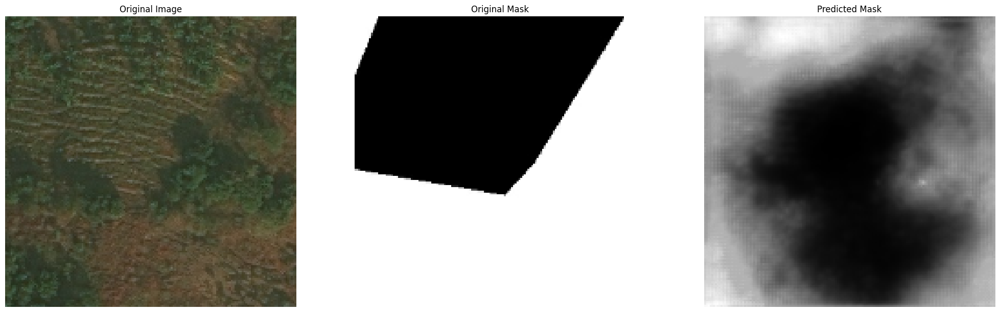

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2072 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6944 - loss: 0.3576 - val_MeanIoU: 0.2351 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6398 - val_loss: 0.4517
Epoch 42/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - MeanIoU: 0.2052 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6878 - loss: 0.369


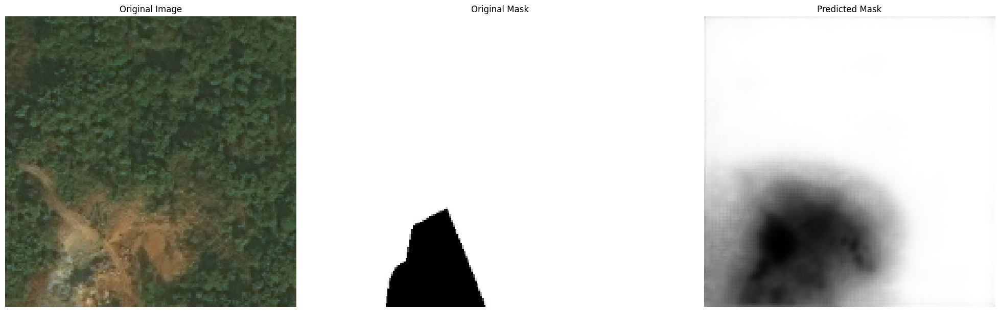

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2053 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6874 - loss: 0.3703 - val_MeanIoU: 0.2146 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6190 - val_loss: 0.4801
Epoch 43/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - MeanIoU: 0.2019 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6970 - loss: 0.374


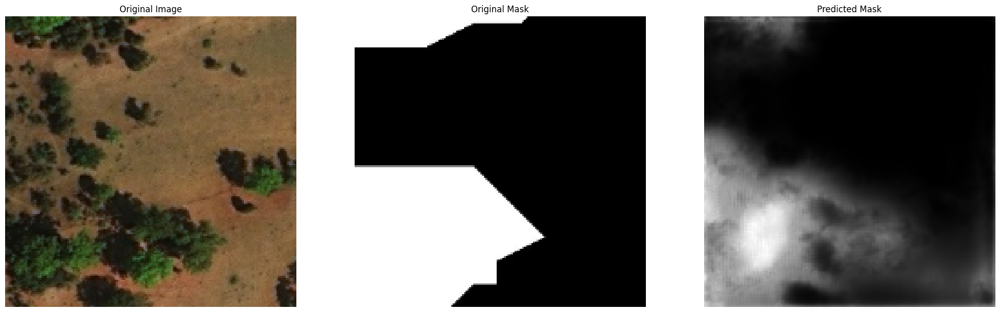

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2020 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6968 - loss: 0.3748 - val_MeanIoU: 0.2058 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7089 - val_loss: 0.3656
Epoch 44/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - MeanIoU: 0.2056 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6960 - loss: 0.357


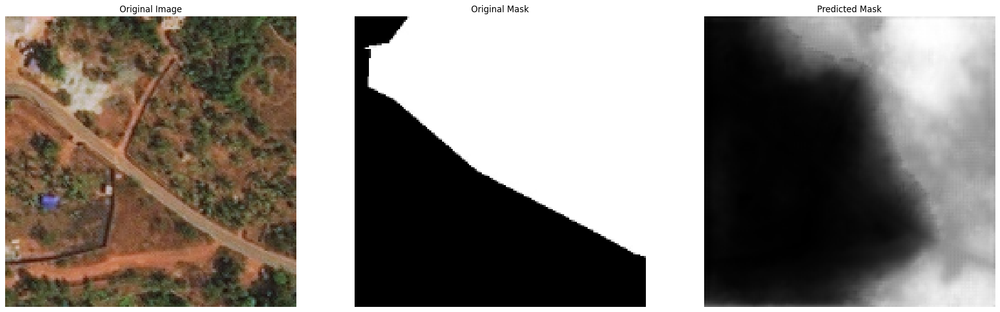

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2055 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6963 - loss: 0.3576 - val_MeanIoU: 0.2261 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6576 - val_loss: 0.4152
Epoch 45/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - MeanIoU: 0.2048 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6932 - loss: 0.357


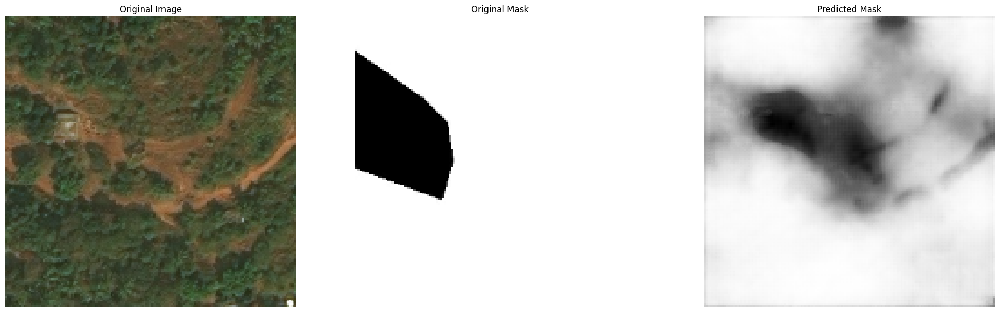

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.2049 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6930 - loss: 0.3579 - val_MeanIoU: 0.2119 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.6908 - val_loss: 0.4689
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - MeanIoU: 0.1956 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.7229 - loss: 0.348


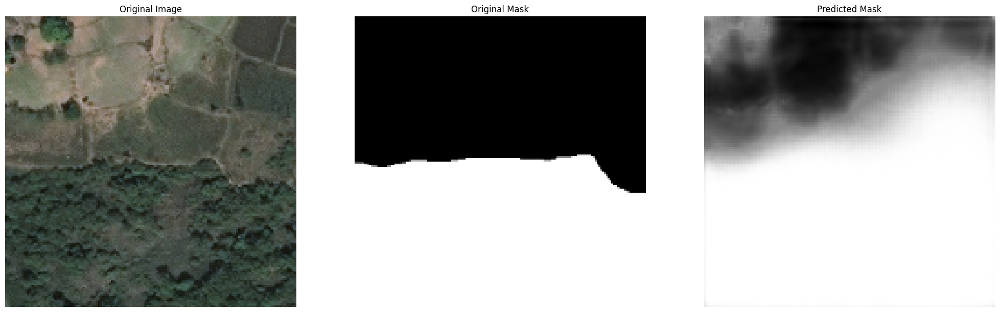

32/32 ━━━━━━━━━━━━━━━━━━━━ 65s 2s/step - MeanIoU: 0.1959 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.7220 - loss: 0.3494 - val_MeanIoU: 0.2000 - val_PixelAccuracy: 0.0000e+00 - val_dice_coeff: 0.7275 - val_loss: 0.3793


In [24]:
# Model Training
unet_model_history = unet_model.fit(
    train_ds,
    validation_data = valid_ds,
    epochs = EPOCHS,
    callbacks = CALLBACKS,
    batch_size = BATCH_SIZE,
)

## Model Learning Curve

In [25]:
# Model History
history = unet_model_history.history
history

{'MeanIoU': [0.1992032825946808,
  0.20723021030426025,
  0.2089681178331375,
  0.20103561878204346,
  0.19850480556488037,
  0.20233049988746643,
  0.20658963918685913,
  0.2036864310503006,
  0.20984354615211487,
  0.2046331912279129,
  0.20716583728790283,
  0.20179182291030884,
  0.20636393129825592,
  0.2093118131160736,
  0.20593519508838654,
  0.2030024528503418,
  0.21003907918930054,
  0.20242716372013092,
  0.20756644010543823,
  0.20600050687789917,
  0.20601294934749603,
  0.20151656866073608,
  0.20484960079193115,
  0.20811578631401062,
  0.20776106417179108,
  0.19975927472114563,
  0.20528320968151093,
  0.2022167146205902,
  0.20413976907730103,
  0.20312047004699707,
  0.20042486488819122,
  0.2013271152973175,
  0.20636247098445892,
  0.20346450805664062,
  0.20794083178043365,
  0.20383527874946594,
  0.20293761789798737,
  0.203046053647995,
  0.2042224109172821,
  0.20371179282665253,
  0.20469354093074799,
  0.2084343433380127,
  0.2064168006181717,
  0.203358635

## Model Predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


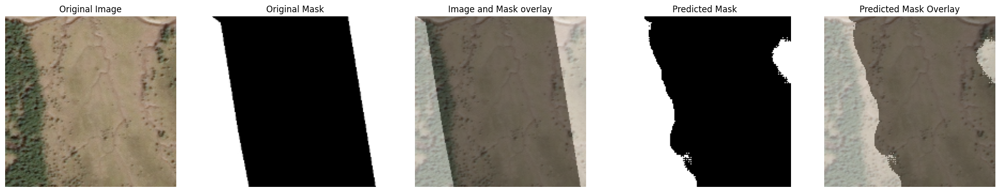

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


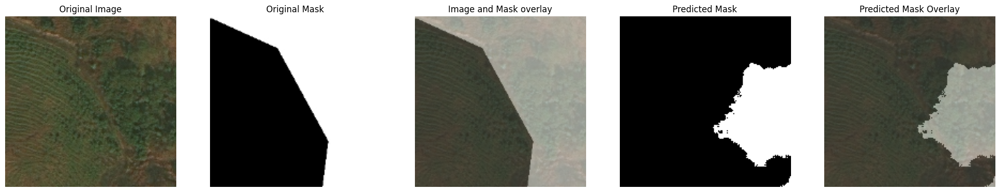

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


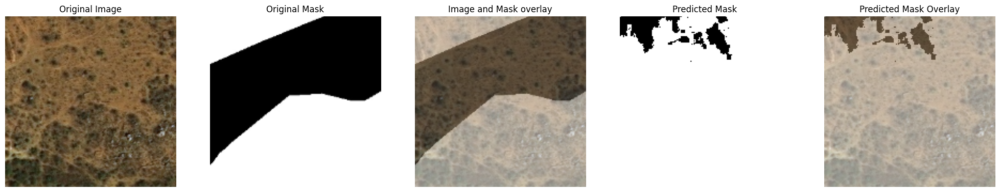

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


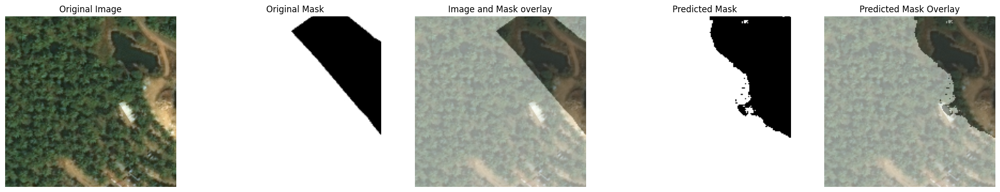

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


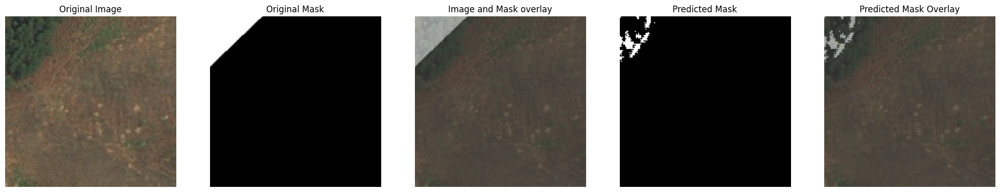

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


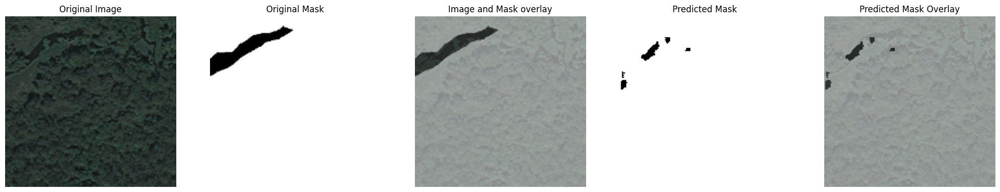

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


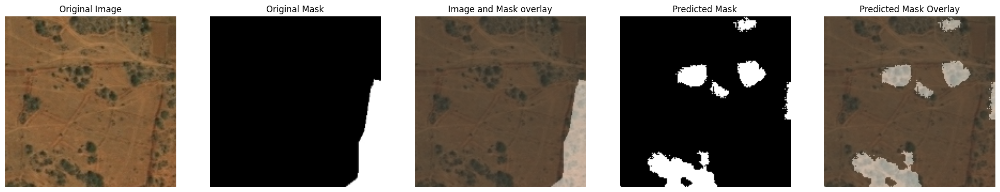

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


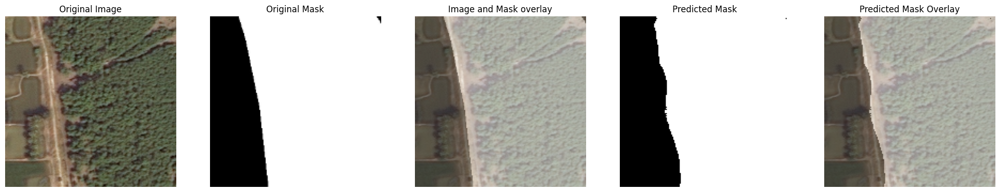

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


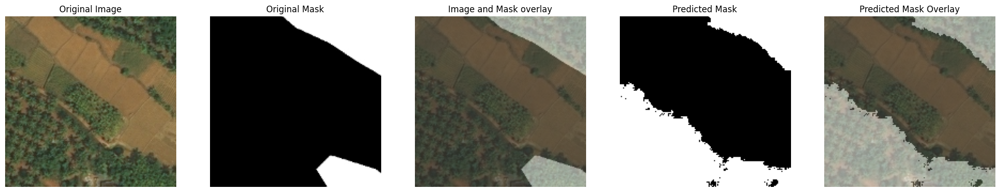

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


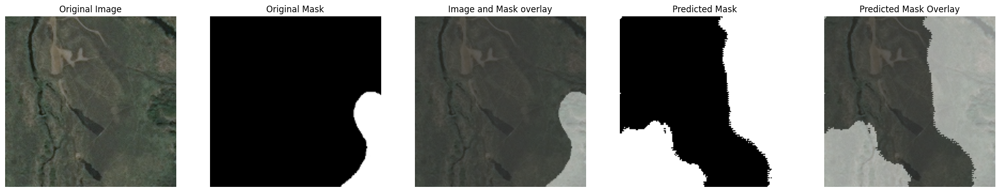

In [26]:
show_images_and_masks(data=train_ds, model=unet_model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


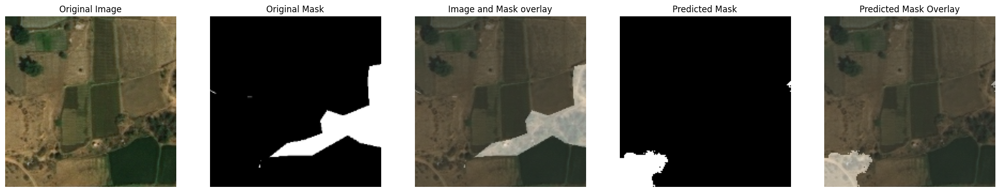

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


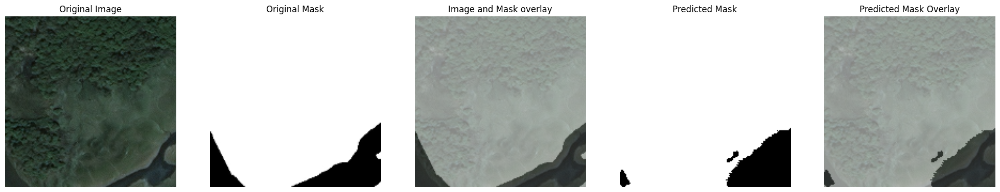

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


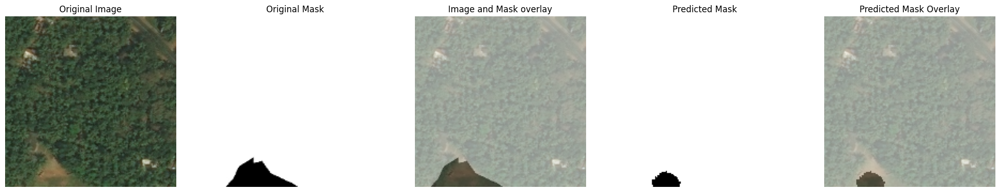

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


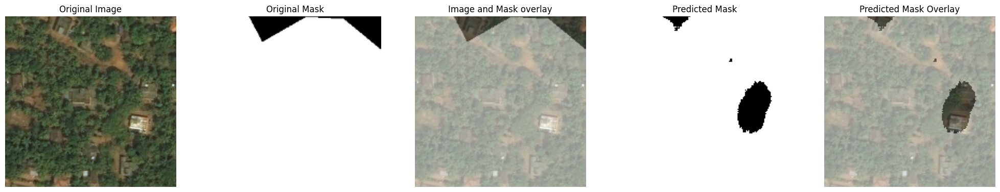

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


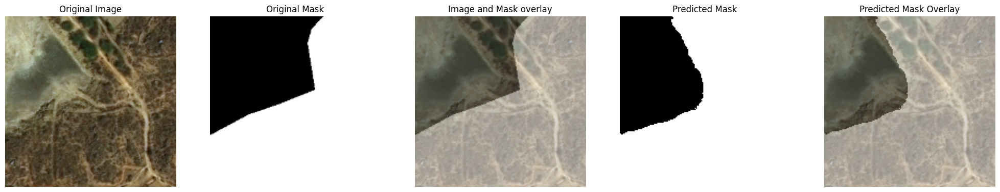

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


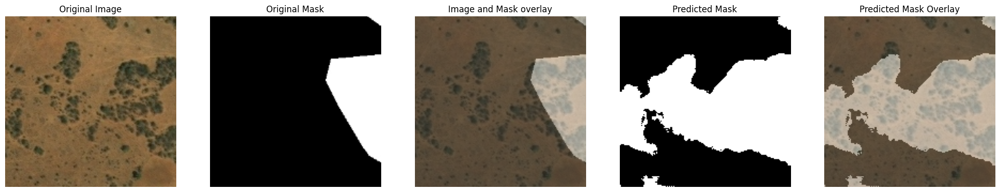

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


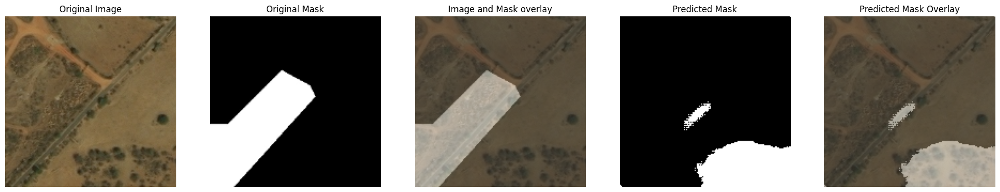

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


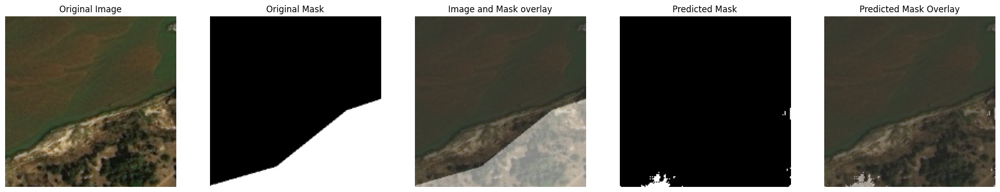

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


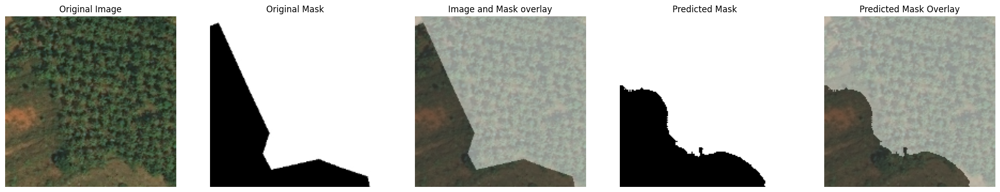

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


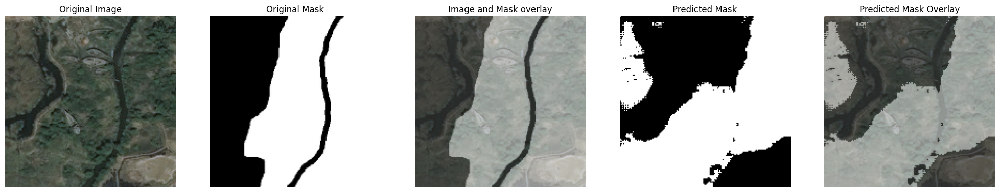

In [27]:
show_images_and_masks(data=valid_ds, model=unet_model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


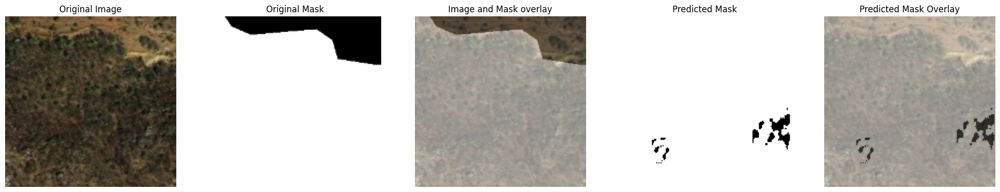

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


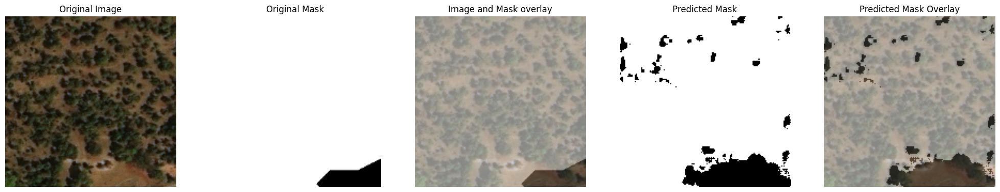

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


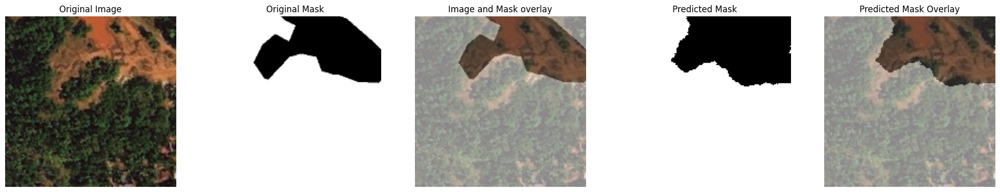

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


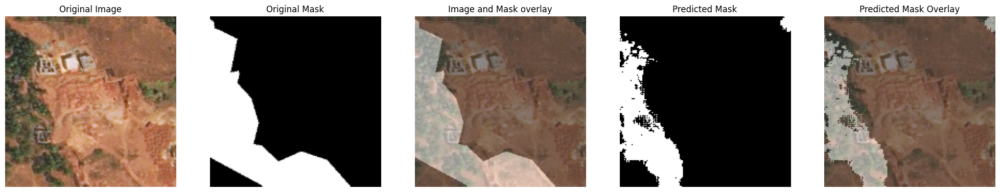

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


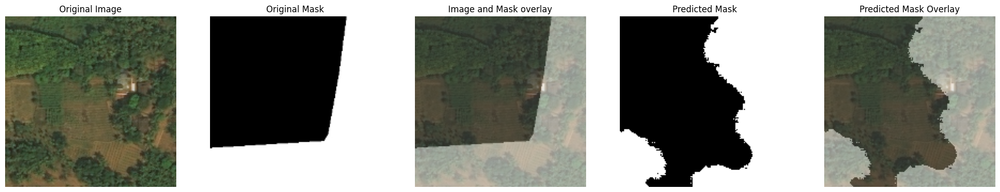

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


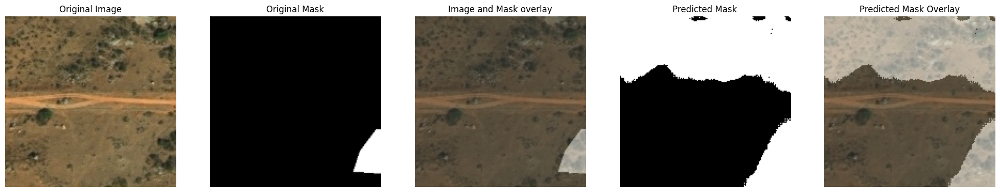

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


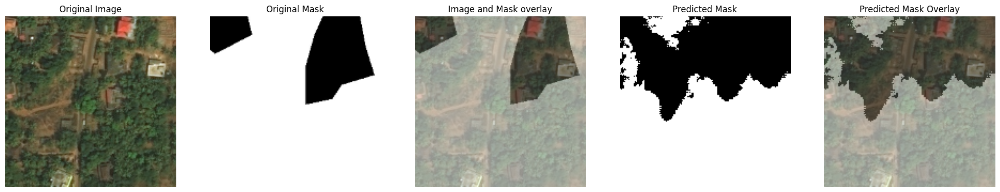

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


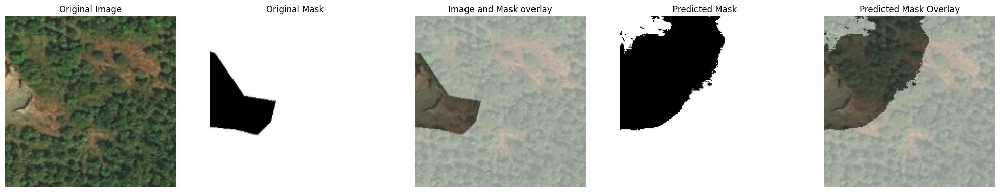

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


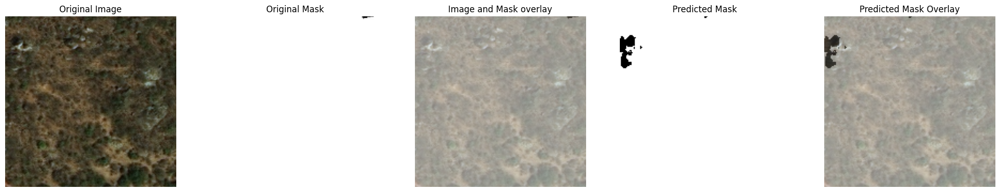

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


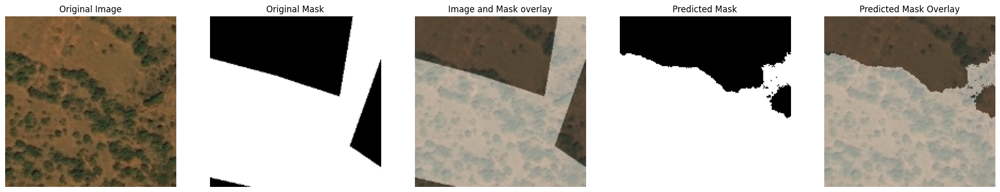

In [28]:
show_images_and_masks(data=test_ds, model=unet_model)

## Evaluation

In [29]:
# U-Net test accuracy 
results = unet_model.evaluate(test_ds, verbose=1)
# print(f'Test Loss: {test_loss:.4f}')
# print(f'Test Accuracy: {test_accuracy:.4f}')
# print(f'Test IoU: {test_iou:.4f}')

7/7 ━━━━━━━━━━━━━━━━━━━━ 3s 491ms/step - MeanIoU: 0.2065 - PixelAccuracy: 0.0000e+00 - dice_coeff: 0.6806 - loss: 0.3672


### Show train and validation loss

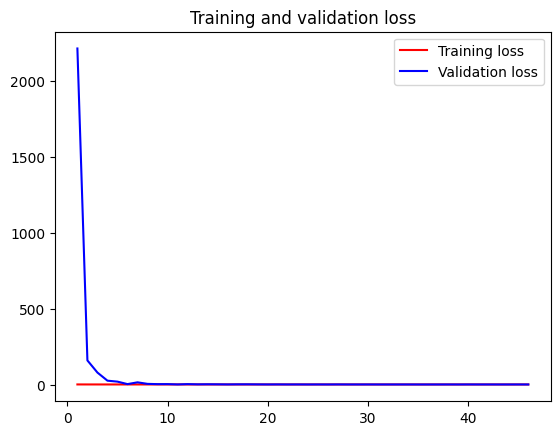

In [30]:
epochs = range(1, len(unet_model_history.history["loss"]) + 1)
loss = unet_model_history.history["loss"]
val_loss = unet_model_history.history["val_loss"]
plt.figure()
plt.plot(epochs, loss, "r", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss")
plt.legend()

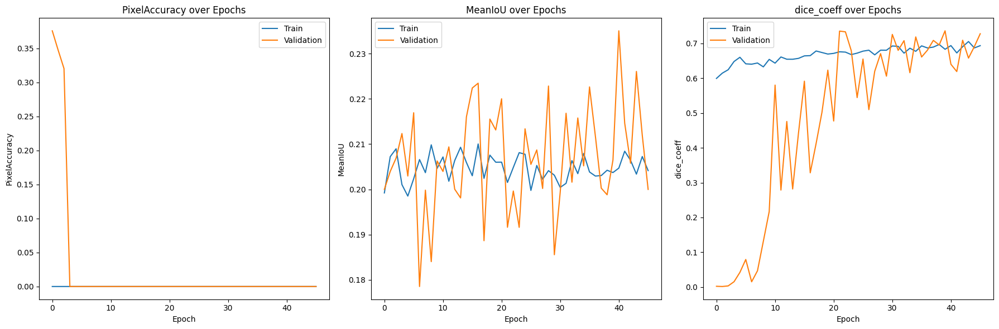

In [32]:
# Extract the history object from the training
history = unet_model_history.history

# Define the list of metrics you want to plot
evaluation_metrics = ['PixelAccuracy', 'MeanIoU', 'dice_coeff']

# Create subplots for each metric
plt.figure(figsize=(18, 6))

for i, metric in enumerate(evaluation_metrics):
    plt.subplot(1, len(evaluation_metrics), i + 1)
    plt.plot(history[metric], label='Train')
    plt.plot(history[f'val_{metric}'], label='Validation')
    plt.title(f'{metric} over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel(metric)
    plt.legend()

plt.tight_layout()
plt.show()